In [162]:
import pandas as pd 
import numpy as np
import folium
import math
import time
from scipy import stats
pd.options.mode.chained_assignment = None  # default='warn'
from plotnine import ggplot, aes, geom_line, geom_point, geom_bar, geom_boxplot
dataframe = pd.read_csv('/home/ruben/tmp/HH_intro_git_ds/precios_casas_sinduplicados.csv')
import scipy.stats as ss
import matplotlib.pyplot as plot
import seaborn as sb
from seaborn import kdeplot
def quartile_skew(x):
  q = x.quantile([.25, .50, .75]) 
  return ((q[0.75] - q[0.5]) - (q[0.5] - q[0.25])) / (q[0.75] - q[0.25])


def mostrar_analisis_var_cuantitativas(data):
    #calcular coeficiente de variacion
 datos_variable=pd.DataFrame([{"coeficiente de Variacion":(data.std()/data.mean())*100,\
                 "rango de la variable":data.max() - data.min(),
                 "rango intercuartilico":data.quantile(0.75) - data.quantile(0.25),
                 "coeficiente de asimetria":quartile_skew(data),
                 "Min":data.min(),
                 "Max":data.max(),
                 "Mean":data.mean()}])
 return(datos_variable)

def mostrar_graf_variables_continuas(df_data,column):
    sb.set_theme(style="whitegrid")
    fig, (ax1,ax2) = plot.subplots(1,2,figsize=(12,6))
    sb.histplot(data=df_data,x=column,ax=ax1)
    sb.boxplot(data=df_data,x=column,ax=ax2)
    sb.displot(data=df_data, x=column,kind="kde",rug=True)
    return plot.show()
def mostrar_graf_variables_discretas(df_data,column):
    sb.set_theme(style="whitegrid")
    fig, (ax1,ax2) = plot.subplots(1,2,figsize=(12,6))
    sb.boxplot(data=df_data,x=column,ax=ax1)
    sb.countplot(data=df_data,x=column,ax=ax2)
    plot.show()

En primer lugar vamos a realizar una inspeccion ocular del dataset:


In [2]:

dataframe2016=dataframe[dataframe["Date"].str[-4:] =='2016']
dataframe2016.describe()
print("precio medio 2016 ",dataframe2016["Price"].mean())
dataframe2017=dataframe[dataframe["Date"].str[-4:] =='2017']
print("precio medio 2017 ",dataframe2017["Price"].mean())
dataframe2017.describe()
dataframe2018=dataframe[dataframe["Date"].str[-4:] =='2018']
print("precio medio 2018 ",dataframe2018["Price"].mean())
dataframe2017.describe()
dataframe.head()

precio medio 2016  1022499.8072289156
precio medio 2017  1003443.1982168043
precio medio 2018  970665.7519626565


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,783079.0,SS,Jellis,3/09/2016,2.5,3067.0,1.0,1.0,126.0,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.0,1.0,202.0,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.0,0.0,156.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,975391.0,VB,Rounds,4/02/2016,2.5,3067.0,2.0,1.0,0.0,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,2.0,0.0,134.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


Vemos que tenemos en total 21 variables algunas con aspecto de ser cualitativas y otras cuantitativas. En los proximos puntos iremos analizando las caracteristitcas de las mismas.
Vemos ne primer lugar el tipo de las variables:

In [3]:
dataframe.dtypes
len(dataframe["Suburb"].unique())

351

In [4]:
aux=pd.DataFrame({"Suburb":pd.value_counts(dataframe['Suburb']),"Method":pd.value_counts(dataframe['Method']),\
                  "Regionname":pd.value_counts(dataframe['Regionname']),"SellerG":pd.value_counts(dataframe['SellerG']),\
                 "Method":pd.value_counts(dataframe['Method']),"CouncilArea":pd.value_counts(dataframe['CouncilArea'])})
aux

,Suburb,Method,Regionname,SellerG,CouncilArea
@Realty,NaN,NaN,NaN,12.0,NaN
A,NaN,NaN,NaN,1.0,NaN
AIME,NaN,NaN,NaN,1.0,NaN
ASL,NaN,NaN,NaN,5.0,NaN
Abbotsford,137.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...
iProperty,NaN,NaN,NaN,1.0,NaN
iSell,NaN,NaN,NaN,32.0,NaN
iTRAK,NaN,NaN,NaN,33.0,NaN
viewbank,1.0,NaN,NaN,NaN,NaN


In [5]:
print(dataframe.describe())
aux=pd.DataFrame({"Suburb":dataframe["Suburb"].describe(),"CouncilArea":dataframe["CouncilArea"].describe(),\
                  "Regionname":dataframe["Regionname"].describe(),"SellerG":dataframe["SellerG"].describe(),\
                 "Method":dataframe["Method"].describe()})
aux

              Rooms         Price      Distance      Postcode      Bathroom  \
count  34857.000000  3.485700e+04  34856.000000  34856.000000  34857.000000   
mean       3.031012  1.004638e+06     11.184929   3116.062859      1.515879   
std        0.969933  6.018564e+05      6.788892    109.023903      0.710011   
min        1.000000  1.165300e+04      0.000000   3000.000000      0.000000   
25%        2.000000  6.181150e+05      6.400000   3051.000000      1.000000   
50%        3.000000  8.500000e+05     10.300000   3103.000000      1.000000   
75%        4.000000  1.231000e+06     14.000000   3156.000000      2.000000   
max       16.000000  1.120000e+07     48.100000   3978.000000     12.000000   

                Car       Landsize     Lattitude    Longtitude  Propertycount  
count  34857.000000   34857.000000  34857.000000  34857.000000   34854.000000  
mean       1.587257     511.352325    -29.984788    111.822439    7572.888306  
std        0.944052    2768.559242     14.502538

,Suburb,CouncilArea,Regionname,SellerG,Method
count,34857,34854,34854,34857,34857
unique,351,33,8,388,9
top,Reservoir,Boroondara City Council,Southern Metropolitan,Jellis,S
freq,844,3675,11836,3359,19744


## 4. Análisis y Transformación de Variables Cualitativas

para cada una de las variables cualitativas del dataframe comprobaremos sus medidas de centralidad y veremos cuales de ellas tiene sentido analizar



In [6]:
dataframe.describe()

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount
count,34857.000000,3.485700e+04,34856.000000,34856.000000,34857.000000,34857.000000,34857.000000,34857.000000,34857.000000,34854.000000
mean,3.031012,1.004638e+06,11.184929,3116.062859,1.515879,1.587257,511.352325,-29.984788,111.822439,7572.888306
std,0.969933,6.018564e+05,6.788892,109.023903,0.710011,0.944052,2768.559242,14.502538,60.912399,4428.090313
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-293.000000,-38.190430,0.000000,83.000000
25%,2.000000,6.181150e+05,6.400000,3051.000000,1.000000,1.000000,217.000000,-37.846900,144.726290,4385.000000
50%,3.000000,8.500000e+05,10.300000,3103.000000,1.000000,1.000000,412.000000,-37.776590,144.974100,6763.000000
75%,4.000000,1.231000e+06,14.000000,3156.000000,2.000000,2.000000,624.000000,-37.634990,145.051750,10412.000000
max,16.000000,1.120000e+07,48.100000,3978.000000,12.000000,26.000000,433014.000000,0.000000,145.526350,21650.000000


**Tabla 3.3.1**  
Antes de empezar el analisis de las variables indicar que el coeficiente de asimetria empleado es el de SKEWNESS por tanto para analizar los resultados podemos usar la sigueiente funcion.  
- Si el coeficiente de asimetría es menor que **-1 o mayor que 1**, la distribución de la variable es **extremadamente sesgada**.  
- Si el coeficiente de asimetría se encuentra entre **-1 y -0,5 o entre 0,5 y 1**, la distribución de la variable es **moderadamente sesgada**.  
- Si el coeficiente de asimetría se encuentra entre **-0,5 y 0,5**, la distribución de la variable es **aproximadamente sesgada**.  

### 4.3.1 Analisis de la variable Rooms

Esta variable contiene el número de habitaciones de cada propiedad que hay en la muesta. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 34857 toma valores discretos en el rango 1 a 16 dormitorios, que es el máximo encontrado. La mitad de la muestra tiene tres habitaciones o menos y el 75% de pisos tienen entre 1 y 4 habitaciones.
A continuacion vamos a ver las frecuencias de la variable

In [7]:
pd.value_counts(dataframe['Rooms'])/dataframe["Rooms"].count()


3     0.432739
2     0.239034
4     0.228247
5     0.049832
1     0.042431
6     0.005852
7     0.000918
8     0.000545
10    0.000172
9     0.000115
12    0.000086
16    0.000029
Name: Rooms, dtype: float64

Como se puede ver mas de un 40% de los pisos vendidos tienen 3 dormitorios que es mas del doble del porcentaje del numero de pisos que tiene 2 dormitorios (un 23%) o 4 dormitorios(un 22,8%).

Pasamos a hacer el cálculo de las medidas de dispersión y simetria calcularemos el coficiente de variación, rango, IQR y simtetria:

In [8]:
mostrar_analisis_var_cuantitativas(dataframe["Rooms"])

,coeficiente de Variacion,rango de la variable,rango intercuartilico,coeficiente de asimetria,Min,Max,Mean
0,32.000296,15,2.0,0.0,1,16,3.031012


Como se puede var en la tabla anterio la variable tiene un coeficiente de variacion del 32% con un coeficiente de asimetria igual a 0 por que la variable es simetrica.



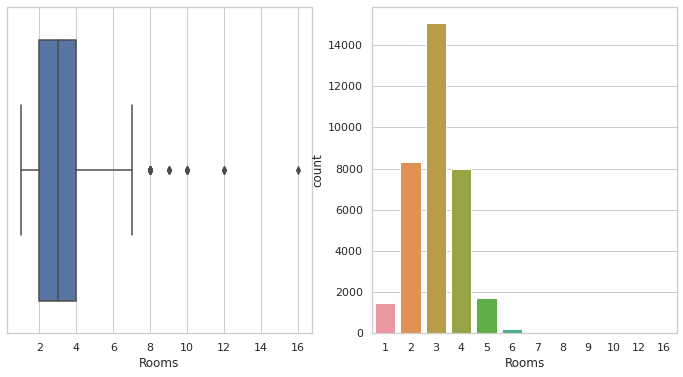

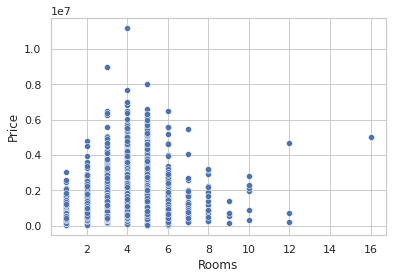

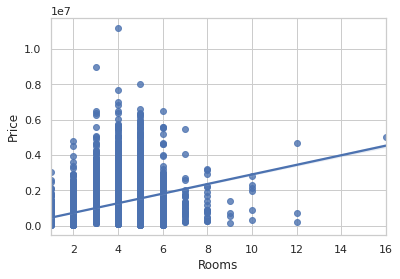

In [9]:
mostrar_graf_variables_discretas(dataframe,"Rooms")
dataframe["Rooms_TR"]=dataframe["Rooms"].apply(np.sqrt)
sb.scatterplot(data=dataframe, x="Rooms", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
sb.regplot(x="Rooms", y="Price", data=dataframe);
plot.show()


Como ya se habia comprobado numéricamente la variable es muy simetrica aunque se aprecia unos outliers, viviendas de mas de 7 dormitorios que posteriormente veremos que efecto tienen en los modelos.  
A priori no parece necesario tratar de ningún modo esta variable por ser simétrica y los outliers no parecen ser error de muestra.

### 4.3.2 Analisis de la variable Bedroom2
Esta variable contiene el numero de dormitorios de cada propiedad. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26640 elementos de la muestra.Toma valores discretos en el rango 0 a 30 dormitorios, que es el máximo encontrado. La mitad de la muestra tiene tres dormitorios o menos y el 75% de pisos tienen entre 0 y 4 dormitorios. Estas cifras llaman la atencion ya que **el máximo numero de habitaciones de la variable rooms tenia como maximo 16**, por lo que esos datos puede que estén mal imputados.

In [11]:
pd.value_counts(dataframe['Bedroom2'])/dataframe["Bedroom2"].count()

KeyError: 'Bedroom2'

Los resultados son muy parecidos a los obtenidos con la variable Rooms por lo que no es probable que la variable rooms haga referencia tambien a numero de dormitorios y no solo de habitaciones. Como ya ocurria con la variable rooms casi el 89% de las propiedades tiene entre 2 y 4 dormitorios.
Vamos a verificar las medidas de dispersión y asimetria de la variable

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Bedroom2"])

El coeficiente de variacion es muy similar a la variable rooms y con el mismo rango intercuantilico, aunque en este caso el coficiente de asimetria es 0 lo que parece indica que se trata de una distribucion simétrica de los datos. Lo verificaremos con los siguientes diagramas:

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Bedroom2")

como ya se habia comprobado numéricamente la variable es muy simetrica aunque se aprecia unos outliers, viviendas de mas de 7 dormitorios que se deberian eliminar. También habra que seleccionar que variable es de mejor calidad para llevar a cabo el modelo.

En este caso la variable tiene un coeficiente de asimetria 0 y algún outlier que veremos posteriormente como afecta al modelo 

### 4.3.3 Analisis de la variable Distance
La variable Distance indica la distancia al centro del inmbueble y toma como unidad las millas. Como se puede ver en la tabla 3.3.1 esta variable tiene valores en 34856 elementos de la muestra. La variable toma valores entre 0 y 48 millas , el 50% de los pisos de la muestra se encuentran a menos de 10,3 millas del centro de la ciudad y la desviacion tipica es 6,78. 
Calculamos medidas de dispersión y simetriía ya que las de centralidad las hemos visto en la tabla 3.3.1


In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Distance"])

segun el coeficiente la varibale parece bastante simetrica, vemaos el boxplot para cerciorarnos.
Vemos la distribucion de la variable y posibles outliers

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Distance")

¿que se ve aqui?

como indica el coeficiente de asimetria , la variable es ligeramente asimetrica, vamos a intentar que se ajuste mejor a una distribucion normal

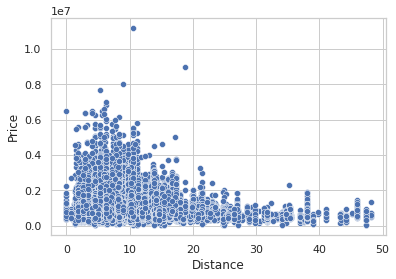

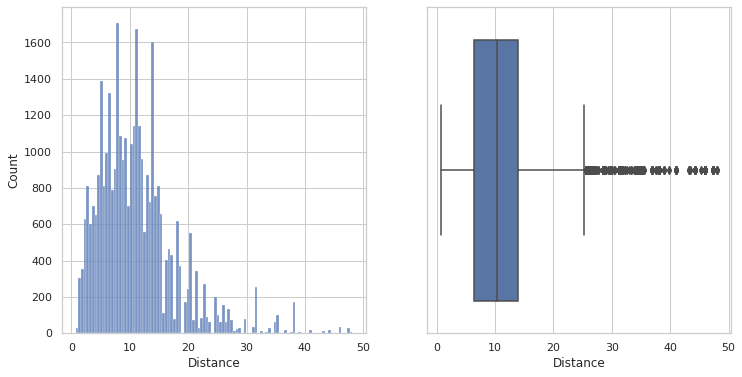

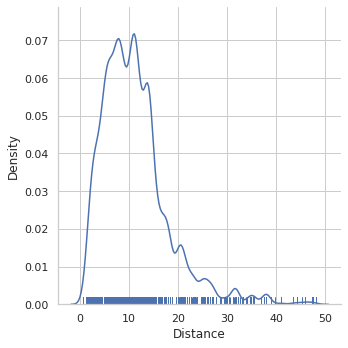

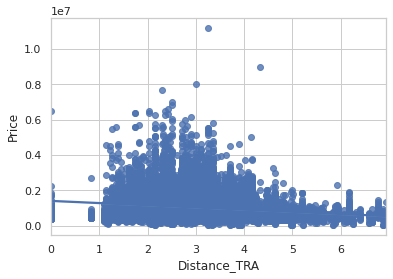

/home/ruben/anaconda3/lib/python3.7/site-packages/numpy/core/function_base.py:153: RuntimeWarning: invalid value encountered in multiply
/home/ruben/anaconda3/lib/python3.7/site-packages/numpy/linalg/linalg.py:1965: RuntimeWarning: invalid value encountered in greater


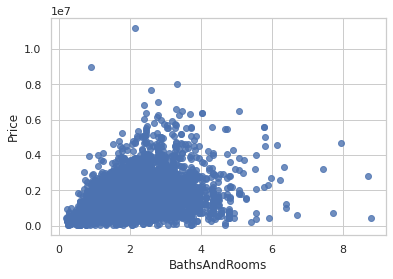

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount,Rooms_TR,BathsAndRooms,Distance_TRA
Rooms,1.000000,0.437651,0.271511,0.085890,0.658195,0.458828,0.047956,-0.141514,0.128332,-0.071677,0.990772,0.529516,0.303786
Price,0.437651,1.000000,-0.215423,0.034814,0.417024,0.233005,0.038241,-0.114850,0.103752,-0.053696,0.438592,0.548326,-0.199581
Distance,0.271511,-0.215423,1.000000,0.481566,0.141792,0.246050,0.064098,-0.026576,0.021389,-0.018140,0.286191,-0.469538,0.975137
Postcode,0.085890,0.034814,0.481566,1.000000,0.113380,0.070404,0.042466,-0.019164,0.013918,0.017108,0.083589,-0.136952,0.409997
Bathroom,0.658195,0.417024,0.141792,0.113380,1.000000,0.420225,0.053903,-0.283318,0.270134,-0.051433,0.642804,0.599030,0.155922
Car,0.458828,0.233005,0.246050,0.070404,0.420225,1.000000,0.053259,-0.253169,0.244089,-0.028088,0.462041,0.178059,0.271195
Landsize,0.047956,0.038241,0.064098,0.042466,0.053903,0.053259,1.000000,-0.041225,0.040605,-0.022418,0.047700,0.021934,0.053085
Lattitude,-0.141514,-0.114850,-0.026576,-0.019164,-0.283318,-0.253169,-0.041225,1.000000,-0.990660,0.021103,-0.145084,-0.179138,-0.025643
Longtitude,0.128332,0.103752,0.021389,0.013918,0.270134,0.244089,0.040605,-0.990660,1.000000,-0.019837,0.131587,0.166804,0.021833
Propertycount,-0.071677,-0.053696,-0.018140,0.017108,-0.051433,-0.028088,-0.022418,0.021103,-0.019837,1.000000,-0.076877,-0.021583,-0.044839


In [12]:
#dataframe=dataframe[dataframe["Distance"].notna()] 

dataframe["BathsAndRooms"]=(dataframe["Rooms"]+dataframe["Bathroom"])/dataframe["Distance"].apply(np.sqrt)

dataframe_filtered=dataframe[dataframe["Distance"] >0]

dataframe_filtered.reset_index(drop=True,inplace=True)
sb.scatterplot(data=dataframe, x="Distance", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
#dataframe_filtered["Distance_TRA"]=stats.boxcox(dataframe_filtered["Distance"])[0]

dataframe["Distance_TRA"]=dataframe["Distance"].apply(np.sqrt)


#sb.displot(data=dataframe_filtered, x="Distance_TRA",y="Price")
#plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe_filtered,"Distance")
sb.regplot(x="Distance_TRA", y="Price", data=dataframe);
plot.show()
sb.regplot(x="BathsAndRooms", y="Price", data=dataframe);
plot.show()


dataframe.corr()

¿que hacemos con esto?

¿que hacemos con esto

### 4.3.4 Analisis de la variable Bathrooms

Esta variable indica el número de baños del inmuble.Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26631 elementos de la muestra. Toma valores discretos en el rango 0 a 12 dormitorios. El 75% de pisos tienen entre 0 y 2 baños . A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
pd.value_counts(dataframe['Bathroom'])/dataframe["Bathroom"].count()

Como se puede ver en la tabla anterior el 89% de la muestra tiene igual o menos de dos dormitorios comn una media de 1,6 baños. En la tabla 3.3.1 respecto a las medidas de dispersión podemos ver que la desviacion típica es de 0,72 y en la siguiente tabla vemos mas variables de dispersión y asimetria:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Bathroom"])

El coeficiente de variación es del 44% y el coeficiente de asimetria es -1 lo que indica que la variable es moderadamente sesgada, tiene cola a la derecha. comprobaremos esto mismo de manera visual pintando su histograma y boxplot

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Bathroom")

sb.regplot(x="Bathroom", y="Price", data=dataframe);
plot.show()

In [ ]:
sb.scatterplot(data=dataframe, x="Bathroom", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

In [ ]:
dataframe_filtered=dataframe[(dataframe["Bathroom"]>0) & (dataframe["Bathroom"] is not None)]
dataframe["Bathroom_TRA"]=dataframe["Bathroom"].apply(np.sqrt)
dataframe["Price_TRA"]=dataframe["Price"].apply(np.sqrt)
dataframe["Price_TRA"]=np.log2(dataframe["Price"])
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
sb.scatterplot(data=dataframe, x="Bathroom_TRA", y="Price")
mostrar_graf_variables_continuas(dataframe,"Bathroom_TRA")
plot.show()

sb.displot(data=dataframe, x="Bathroom_TRA",y="Price_TRA",kind="kde")
plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe,"Bathroom_TRA")
sb.regplot(x="Bathroom_TRA", y="Price_TRA", data=dataframe);
plot.show()
#hola

NI idea de que hacer con esta variable si es que hay que hacer algo...

### 4.3.5 Analisis de la variable Car

Esta variable contiene el numero de plazas de aparcamiento que tiene asociadas la vivienda. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 26129 de la muestra y toma valores discretos en el rango 0 a 26 plazas de aparcamiento. El 75% de pisos tienen entre 0 y 2 plazas de aparcamiento . A continuacion vamos a ver las frecuencias de la variable:


In [ ]:
pd.value_counts(dataframe['Car'])/dataframe["Car"].count()

como se puede ver casi el 47% de las casas de la muestra tienen dos plaza de aparcamiento y el 81% entre 1 y 2 plazas de aparcamiento.Respecto a las medidas de dispersión, en la tabla 3.3.1 podemos ver que la desviacion típica es de 1.01. En la siguiente tabla vemos mas variables de dispersión y asimetria:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Car"])

como se puede ver hay un coeficiente de variación alto y asimetria por la izquierda que verificaremos mejor haciendo algunos diagramas

In [ ]:
mostrar_graf_variables_discretas(dataframe,"Car")

In [ ]:
sb.scatterplot(data=dataframe, x="Car", y="Price")
mostrar_graf_variables_continuas(dataframe,"Car")
plot.show()

### 4.3.6 Analisis de la variable Landsize

Esta variable contiene el tamaño del terreno asociado a la vivienda, excluye los metros de la vivienda y está calculada en metros cuadrados. La media de terreno asociado al inmbueble es de  593.598993  El 75% de pisos tienen menos de 670 metros cuadrados de parcela. A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Landsize"])

la variable es aproximadamente sesgada a la izquierda y con un rango de valores muy amplio.pintamos algunos gráficos para entender mejor la asimietria y la dispersión del a variablable

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Landsize")

vamos a eliminar el registro superior que está desvirtuando el gráfico para poder analizarlo con mas detalle

In [ ]:
#Eliminamos outliers superiores para poder seguir analizando 
df_filtered=dataframe[dataframe["Landsize"]<20000]
print("registros filtrado = ",(dataframe["Landsize"].count()-df_filtered["Landsize"].count()))
mostrar_graf_variables_continuas(df_filtered,"Landsize")



sb.scatterplot(data=df_filtered, x="Landsize", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

Continua habiendo outliers que hacen que la variabe sea muy dispersa por lo que la variable es clara condidata a ser transformada

In [ ]:
#dataframe=dataframe[dataframe["Distance"].notna()] 

dataframe_filtered=dataframe[(dataframe["Landsize"]>0) ]

#dataframe_filtered.reset_index(drop=True,inplace=True)

#dataframe_filtered["Landsize_TRA"]=stats.boxcox(dataframe_filtered["Distance"])[0]

#dataframe_filtered["Landsize_TRA"]=dataframe_filtered["Landsize"].apply(np.sqrt)
dataframe_filtered["Landsize_TRA"]=np.log(dataframe_filtered["Landsize"])



sb.scatterplot(data=dataframe_filtered, x="Landsize_TRA", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()
#dataframe_filtered['Landsize_TRA'] = np.where(dataframe['Landsize'] >= 40000, 40000, (dataframe['Landsize']//100)*100)
#dataframe_filtered['Landsize_TRA'] = np.where(dataframe_filtered['Landsize_TRA'] <= 70, 70, dataframe_filtered['Landsize_TRA'])


sb.displot(data=dataframe_filtered, x="Landsize_TRA",y="Price")
plot.show()
#dataframe["Distance_SQR"]=dataframe["Distance"].apply(np.sqrt)
#sb.scatterplot(data=dataframe, x="Distance", y="Price")
#plot.show()
mostrar_graf_variables_continuas(dataframe_filtered,"Landsize_TRA")


### 4.3.7 Analisis de la variable BulldingArea

Esta variable contiene el el tamaño del terreno asociado a la vivienda en metros cuadrados. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 13742 elementos de la muestra.La media del tamaño de los inmubles de 160.25640 y toma valores continuos en el rango 0 a 44515 . El 75% de pisos tienen menos de 188.00000 metros cuadrado. A continuacion vamos a ver las medidas de dispersión de la varibale:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["BuildingArea"])

como se puede ver la variable tiene asimetria a la derecha, pero en la tabla inicial vimos que la desviación estándar era muy alta para el valor que tomaba la media. Pasamos a comprobar visualmente la simetria

In [ ]:
mostrar_graf_variables_continuas(dataframe,"BuildingArea")

como se puede ver hay claramente algún outlier que desvirtua la muestra (ya lo pudimos ver tambien en la tabla 3.1.1 donde la media era de 522 y el maximo era mas de 44000 metros cuadrados de parcela).
Eliinamos el el maximo en cuestión y repiintamos los graficos

In [ ]:
#Eliminamos el maximo y vemos que ocurre
df_filtered=dataframe[dataframe["BuildingArea"]<1000]
print("registros filtrado = ",(dataframe["BuildingArea"].count()-df_filtered["BuildingArea"].count()))
mostrar_graf_variables_continuas(df_filtered,"BuildingArea")
#df_filtered["BuildingArea_TRA"]=np.log(dataframe_filtered["BuildingArea"])
df_filtered["BuildingArea_TRA"]=df_filtered["Distance"].apply(np.sqrt)
sb.scatterplot(data=df_filtered, x="BuildingArea_TRA", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()



df_filtered=dataframe[dataframe["YearBuilt"]>1800]

sb.scatterplot(data=df_filtered, x="YearBuilt", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

Los datos sin ese registro tienen mejor aspecto y parecen muy concentrados. Lo tendremos en cuenta cuando tratemos la variables.

### 4.3.8 Analisis de la variable PropertyCountss

Esta variable contiene el numero de viviendas existentes en el barrio. Como se puede ver en la tabla 3.3.1 la variable tiene valor en 34854 y toma valores discretos en el rango 83 a 21650(que es el maximo de viviendas en un bbarrio). El 75% de pisos están en barrios con 10412 viviendas o menos.
A continuacion vamos a ver las frecuencias de la variable:

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Propertycount"])

La variable es aproximadamente sesgada a la derecha , lo comprobaremos visalmente:

In [ ]:
mostrar_graf_variables_continuas(dataframe,"Propertycount")

### 4.3.1 Analisis de la variable Latitud 

Esta variable contiene la coordenada geográfica correspondiente a la latitud del inmueble. Como se puede ver en la tabla de abajo

In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Lattitude"])


In [ ]:
mostrar_analisis_var_cuantitativas(dataframe["Longtitude"])

In [161]:
import geopy.distance 
import geopandas
import numpy as np
from shapely.geometry import Point
from geopy.distance import distance
import geopy
from geopy.geocoders import Nominatim
# creamos el objeto geolocator

'''
geolocator = Nominatim(user_agent="Modelo-Melbourne")

#normalizamos las direcciones
dataframe["Address_normalized"]=dataframe["Address"].replace("/","") + str(", City of Melbourne") + ", " + dataframe["Postcode"].astype(str).str.slice(stop=4) + str(", Australia")
print(dataframe["Address_normalized"])
Loc=geolocator.geocode("217 Langridge St, City of Melbourne, 3067, Australia")

print(Loc)

def update_latitude(row):
  if ((row["Lattitude"]>-36.0) | (row["Lattitude"]<-38.0)) | ((row["Longtitude"]>146.0) | (row["Longtitude"]<144.0)):
    time.sleep(1)
    Loc=geolocator.geocode(row["Address_normalized"],timeout=None)
    if Loc != None:
        print(row["Address_normalized"])
        row["Lattitude"]=Loc.latitude
        row["Longtitude"]=Loc.longitude
        print(Loc.latitude, Loc.longitude)
        
dataframe.apply(update_latitude, axis=1)


for i,v in  dataframe.iterrows():
    if ((v["Lattitude"]>-36.0) | (v["Lattitude"]<-38.0)) | ((v["Longtitude"]>146.0) | (v["Longtitude"]<144.0)):
        print (v["Address_normalized"])
        Loc=geolocator.geocode(v["Address_normalized"],timeout=None)
        print(dataframe.loc[i]["Lattitude"], dataframe.loc[i]["Longtitude"])
        if Loc != None:
            dataframe.loc[i]["Lattitude"]=Loc.latitude
            dataframe.loc[i]["Longtitude"]=Loc.longitude
            print (v["Address_normalized"])
            print(Loc)
            time.sleep(1)
'''
mapa = folium.Map(location=[-37.810634, 145.001851], zoom_start=11)
data_filtered=dataframe[dataframe['Lattitude'].notnull() & \
                        dataframe['Longtitude'].notnull() &\
                       dataframe['Rooms'].notnull() & \
                       dataframe['Bathroom'].notnull() & \
                       dataframe['Price'].notnull()]
coords_2=(-37.810634,145.001851)



locations=data_filtered[['Lattitude', 'Longtitude']]
locations.round(6)
locationlist=locations.values.tolist()
len(locationlist)
for i,v in  data_filtered.iterrows():
    popup = popup = """
    Bathrooms: <b>%s</b><br>
    Rooms: <b>%s</b><br>
    Suburb : <b>%s</b><br>
    Price : <b>%s</b><br>
    """ % (v['Bathroom'], v['Rooms'], v['Suburb'], v['Price'])
    #print(v['Price'])
    if v['Price'] < float('500000.0'):
        #Color Azul
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#0000FF',
                            fill_color='#0000FF',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('500000.0')) & (v['Price'] < float('800000.0')):
        #color Verde
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#00FF40',
                            fill_color='#00FF40',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('800000.0')) & (v['Price'] < float('1200000.0')):
        #Color Amarillo
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#FFFF00',
                            fill_color='#FFFF00',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1200000.0'))& (v['Price'] < float('1500000.0')):
        #Color cian
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#00fff7',
                            fill_color='#00fff7',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1500000.0'))& (v['Price'] < float('1800000.0')):
        #Color Rojo
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#ff2300',
                            fill_color='#ff2300',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('1800000.0'))& (v['Price'] < float('2100000.0')):
        #Color Naranja
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#ffc900',
                            fill_color='#ffc900',
                            fill=True, radius=1 ).add_to(mapa)
    elif  (v['Price'] >= float('2100000.0')):
        #Color Morado
        folium.CircleMarker(location=[v['Lattitude'], v['Longtitude']], tooltip=popup,
                            color='#f700ff',
                            fill_color='#f700ff',
                            fill=True, radius=1 ).add_to(mapa)
folium.Marker(location=('37.84280999999999','145.03483'), tooltip=popup,
                            color='#f711ff',
                            fill_color='#ffffff',
                            fill=True, radius=20 ).add_to(mapa)
mapa  

-37.7925704 144.9346231


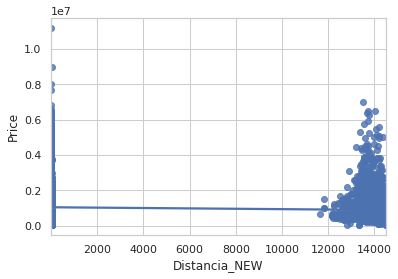

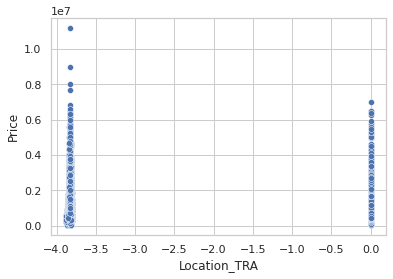

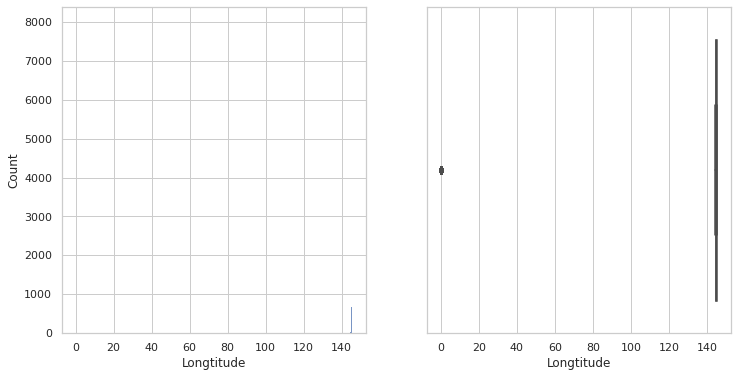

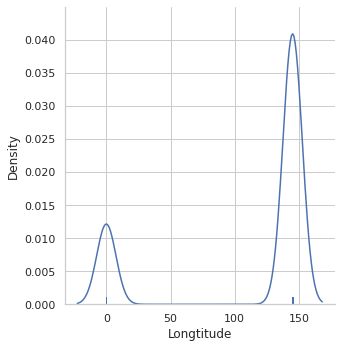

ValueError: Could not interpret value `Price_TRA` for parameter `y`

In [157]:
arr=[]
for lat, lon in zip(data_filtered['Lattitude'], data_filtered['Longtitude']):
    arr.append(distance((lat,lon), coords_2).km)

data_filtered["Distancia_NEW"]=arr
dataframe.describe()

#df_fil=dataframe[(dataframe["Lattitude"] is not None) & (dataframe["Longtitude"] is not None)]
dataframe["Location_TRA"]=dataframe.Longtitude/dataframe.Lattitude
dataframe_less=dataframe[(dataframe["Lattitude"]>=dataframe["Lattitude"].mean()) ]
dataframe_over=dataframe[(dataframe["Lattitude"]<dataframe["Lattitude"].mean()) ]

sb.regplot(data=data_filtered, x="Distancia_NEW", y="Price")
plot.show()
#mostrar_graf_variables_continuas(dataframe,"Location_TRA")
sb.scatterplot(data=dataframe, x="Location_TRA", y="Price")
mostrar_graf_variables_continuas(dataframe,"Longtitude")
plot.show()

dataframe_min=dataframe[dataframe["Lattitude"]>=dataframe["Lattitude"].mean()]
#dataframe["Lattitude_TRA"]=np.log(dataframe["Lattitude"])
#dataframe["Price_TRA"]=np.log(dataframe["Price"])
#mostrar_graf_variables_continuas(dataframe,"Location_TRA")
sb.scatterplot(data=dataframe, x="Lattitude", y="Price_TRA")
mostrar_graf_variables_continuas(dataframe,"Lattitude_TRA")
plot.show()

sb.scatterplot(data=dataframe, x="Lattitude_TRA", y="Price_TRA")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

data_filtered.corr()

#sb.swarmplot(data=dataframe, x="Lattitude", y="Longtitude",hue="Price",s = 4)
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
#plot.show()x_estimator=np.mean

#sb.lmplot(x="Location_TRA", y="Price", data=dataframe, x_estimator=np.mean);
#plot.show()

-37.84256166666666 145.03477999999998
5.714112108708466
-37.84256166666666 145.03477999999998
5.74437985816925
-37.84256166666666 145.03477999999998
5.298424573620166
-37.84256166666666 145.03477999999998
4.015895480343206
-37.84256166666666 145.03477999999998
5.125216355675252
-37.84256166666666 145.03477999999998
6.067093782266876
-37.84256166666666 145.03477999999998
5.313382904089238
-37.84256166666666 145.03477999999998
6.123548372931133
-37.84256166666666 145.03477999999998
5.803074835988631
-37.84256166666666 145.03477999999998
5.719949330390096
-37.84256166666666 145.03477999999998
5.505113283325984
-37.84256166666666 145.03477999999998
5.443242594322199
-37.84256166666666 145.03477999999998
5.1229614389987965
-37.84256166666666 145.03477999999998
5.392272179066316
-37.84256166666666 145.03477999999998
5.337487187185163
-37.84256166666666 145.03477999999998
13419.76311197529
-37.84256166666666 145.03477999999998
14390.96040429436
-37.84256166666666 145.03477999999998
5.68990783

-37.84256166666666 145.03477999999998
14441.841386449798
-37.84256166666666 145.03477999999998
14432.516187452564
-37.84256166666666 145.03477999999998
16.266129098480857
-37.84256166666666 145.03477999999998
16.03127104645615
-37.84256166666666 145.03477999999998
15.749574382030133
-37.84256166666666 145.03477999999998
14467.930554253833
-37.84256166666666 145.03477999999998
17.612560760453853
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
17.516740047067184
-37.84256166666666 145.03477999999998
15.54285375627037
-37.84256166666666 145.03477999999998
14162.381506927828
-37.84256166666666 145.03477999999998
14498.027801835284
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
15.788812182684397
-37.84256166666666 145.03477999999998
14134.504227836036
-37.84256166666666 145.03477999999998
17.40112710179305
-37.84256166666666 145.03477999999998
14478.92822558519
-37.84256166666666 145.034779999999

-37.84256166666666 145.03477999999998
2.165808166242727
-37.84256166666666 145.03477999999998
2.64252220929492
-37.84256166666666 145.03477999999998
2.479119341495627
-37.84256166666666 145.03477999999998
2.280452620448793
-37.84256166666666 145.03477999999998
2.484453251228414
-37.84256166666666 145.03477999999998
1.6705955823658398
-37.84256166666666 145.03477999999998
11.582479771035892
-37.84256166666666 145.03477999999998
12.795519984163542
-37.84256166666666 145.03477999999998
12.445024590631919
-37.84256166666666 145.03477999999998
12.505976177708451
-37.84256166666666 145.03477999999998
12.740148881320113
-37.84256166666666 145.03477999999998
14254.73405270835
-37.84256166666666 145.03477999999998
12.258984639835813
-37.84256166666666 145.03477999999998
14.012096757195293
-37.84256166666666 145.03477999999998
12.873251865706516
-37.84256166666666 145.03477999999998
13.33360050472019
-37.84256166666666 145.03477999999998
13.368616231277933
-37.84256166666666 145.03477999999998
1

17.04257995525715
-37.84256166666666 145.03477999999998
17.11433485912482
-37.84256166666666 145.03477999999998
17.574270012276468
-37.84256166666666 145.03477999999998
17.19273422540438
-37.84256166666666 145.03477999999998
17.130551089176603
-37.84256166666666 145.03477999999998
17.23503447340752
-37.84256166666666 145.03477999999998
18.02976983241654
-37.84256166666666 145.03477999999998
14439.039982826793
-37.84256166666666 145.03477999999998
17.699383166129522
-37.84256166666666 145.03477999999998
18.404858190148033
-37.84256166666666 145.03477999999998
17.249389167207454
-37.84256166666666 145.03477999999998
17.33627337523024
-37.84256166666666 145.03477999999998
14055.308733904796
-37.84256166666666 145.03477999999998
17.45309794246757
-37.84256166666666 145.03477999999998
17.56668655136936
-37.84256166666666 145.03477999999998
18.879990530328048
-37.84256166666666 145.03477999999998
14499.143415740522
-37.84256166666666 145.03477999999998
14465.42363885051
-37.84256166666666 14

-37.84256166666666 145.03477999999998
6.382441338106398
-37.84256166666666 145.03477999999998
8.073456803376581
-37.84256166666666 145.03477999999998
7.326976770400686
-37.84256166666666 145.03477999999998
6.463542474425887
-37.84256166666666 145.03477999999998
8.027725607885056
-37.84256166666666 145.03477999999998
6.784542266854289
-37.84256166666666 145.03477999999998
6.185193311205295
-37.84256166666666 145.03477999999998
7.941519145687763
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
8.43092018918079
-37.84256166666666 145.03477999999998
6.820782142772503
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
7.032433101869258
-37.84256166666666 145.03477999999998
7.767394709960281
-37.84256166666666 145.03477999999998
7.951449103816377
-37.84256166666666 145.03477999999998
7.752932283023994
-37.84256166666666 145.03477999999998
8.333788953254512
-37.84256166666666 145.03477999999998
7.1862834

-37.84256166666666 145.03477999999998
14451.764945655616
-37.84256166666666 145.03477999999998
13987.540044462452
-37.84256166666666 145.03477999999998
14216.091910727055
-37.84256166666666 145.03477999999998
14167.835523053562
-37.84256166666666 145.03477999999998
7.9290205292800335
-37.84256166666666 145.03477999999998
9.786704691240224
-37.84256166666666 145.03477999999998
14468.690489905961
-37.84256166666666 145.03477999999998
14008.471382190131
-37.84256166666666 145.03477999999998
14393.449643435131
-37.84256166666666 145.03477999999998
9.250272320762964
-37.84256166666666 145.03477999999998
14154.09026325126
-37.84256166666666 145.03477999999998
13806.739979188626
-37.84256166666666 145.03477999999998
9.151953557679061
-37.84256166666666 145.03477999999998
9.654079962373219
-37.84256166666666 145.03477999999998
9.317369179798652
-37.84256166666666 145.03477999999998
14488.995340094853
-37.84256166666666 145.03477999999998
8.42346230475888
-37.84256166666666 145.03477999999998
8

-37.84256166666666 145.03477999999998
10.029313056511995
-37.84256166666666 145.03477999999998
7.910837109229334
-37.84256166666666 145.03477999999998
8.423036583358897
-37.84256166666666 145.03477999999998
14468.763713045933
-37.84256166666666 145.03477999999998
9.881883513811118
-37.84256166666666 145.03477999999998
10.15450243810966
-37.84256166666666 145.03477999999998
8.953773780392515
-37.84256166666666 145.03477999999998
9.410730195463954
-37.84256166666666 145.03477999999998
14238.396739005011
-37.84256166666666 145.03477999999998
14448.38959289147
-37.84256166666666 145.03477999999998
8.70671406282199
-37.84256166666666 145.03477999999998
7.890603488400779
-37.84256166666666 145.03477999999998
7.8355224442574025
-37.84256166666666 145.03477999999998
7.308301595671983
-37.84256166666666 145.03477999999998
7.5273272680596675
-37.84256166666666 145.03477999999998
13706.559150555398
-37.84256166666666 145.03477999999998
9.307699164482981
-37.84256166666666 145.03477999999998
8.805

-37.84256166666666 145.03477999999998
14442.12766988113
-37.84256166666666 145.03477999999998
8.1838270331729
-37.84256166666666 145.03477999999998
6.7963888738490805
-37.84256166666666 145.03477999999998
6.273968168638699
-37.84256166666666 145.03477999999998
7.752918558784784
-37.84256166666666 145.03477999999998
6.3512678626035575
-37.84256166666666 145.03477999999998
8.94181180433016
-37.84256166666666 145.03477999999998
8.931971995160746
-37.84256166666666 145.03477999999998
8.959424490817677
-37.84256166666666 145.03477999999998
14240.558516150779
-37.84256166666666 145.03477999999998
8.870086330826785
-37.84256166666666 145.03477999999998
6.51247804539031
-37.84256166666666 145.03477999999998
9.15551993617739
-37.84256166666666 145.03477999999998
7.034849363490852
-37.84256166666666 145.03477999999998
14485.61279012577
-37.84256166666666 145.03477999999998
6.379873599275595
-37.84256166666666 145.03477999999998
8.715750336635779
-37.84256166666666 145.03477999999998
8.8138252395

8.719215758787042
-37.84256166666666 145.03477999999998
9.401655680120703
-37.84256166666666 145.03477999999998
7.9946692676165725
-37.84256166666666 145.03477999999998
8.532321141347246
-37.84256166666666 145.03477999999998
9.399088546520616
-37.84256166666666 145.03477999999998
9.049995130212986
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
7.392331541956714
-37.84256166666666 145.03477999999998
8.916873904983353
-37.84256166666666 145.03477999999998
9.943000942269034
-37.84256166666666 145.03477999999998
14226.780886800983
-37.84256166666666 145.03477999999998
14191.589815771475
-37.84256166666666 145.03477999999998
9.740637392038483
-37.84256166666666 145.03477999999998
9.787859666723367
-37.84256166666666 145.03477999999998
9.383559473208033
-37.84256166666666 145.03477999999998
9.740432905567108
-37.84256166666666 145.03477999999998
14485.040181624498
-37.84256166666666 145.03477999999998
8.928648785660938
-37.84256166666666 145.03

10.008540454356199
-37.84256166666666 145.03477999999998
11.402069046647627
-37.84256166666666 145.03477999999998
11.567386754872295
-37.84256166666666 145.03477999999998
10.80881324823007
-37.84256166666666 145.03477999999998
10.761718811544426
-37.84256166666666 145.03477999999998
11.67282302761711
-37.84256166666666 145.03477999999998
10.362313818191353
-37.84256166666666 145.03477999999998
13433.901542338679
-37.84256166666666 145.03477999999998
11.620853784430338
-37.84256166666666 145.03477999999998
10.289178678527703
-37.84256166666666 145.03477999999998
10.918656139096663
-37.84256166666666 145.03477999999998
13858.914012792546
-37.84256166666666 145.03477999999998
9.28931197887567
-37.84256166666666 145.03477999999998
14328.059196043205
-37.84256166666666 145.03477999999998
10.875378998425289
-37.84256166666666 145.03477999999998
10.949275740498589
-37.84256166666666 145.03477999999998
12845.090978980892
-37.84256166666666 145.03477999999998
10.26841825211943
-37.8425616666666

-37.84256166666666 145.03477999999998
14103.469395928156
-37.84256166666666 145.03477999999998
10.068838309133131
-37.84256166666666 145.03477999999998
14499.131832351128
-37.84256166666666 145.03477999999998
9.230647566573253
-37.84256166666666 145.03477999999998
14495.751742686345
-37.84256166666666 145.03477999999998
8.984533431002427
-37.84256166666666 145.03477999999998
8.831049887294007
-37.84256166666666 145.03477999999998
10.732041088722436
-37.84256166666666 145.03477999999998
10.407992075975184
-37.84256166666666 145.03477999999998
10.15985425238343
-37.84256166666666 145.03477999999998
14409.637951146438
-37.84256166666666 145.03477999999998
9.973624991109022
-37.84256166666666 145.03477999999998
14444.5044977565
-37.84256166666666 145.03477999999998
14499.140742651523
-37.84256166666666 145.03477999999998
14458.682158163941
-37.84256166666666 145.03477999999998
14401.01355783306
-37.84256166666666 145.03477999999998
8.655709204670101
-37.84256166666666 145.03477999999998
9.

4.419250231280629
-37.84256166666666 145.03477999999998
13958.0394559481
-37.84256166666666 145.03477999999998
3.7300561713479534
-37.84256166666666 145.03477999999998
14478.917517738455
-37.84256166666666 145.03477999999998
3.428021371761343
-37.84256166666666 145.03477999999998
5.085114259219941
-37.84256166666666 145.03477999999998
14478.917517738455
-37.84256166666666 145.03477999999998
14478.917517738455
-37.84256166666666 145.03477999999998
4.0221070696808985
-37.84256166666666 145.03477999999998
14418.007302610546
-37.84256166666666 145.03477999999998
13250.150655091951
-37.84256166666666 145.03477999999998
4.622007201345592
-37.84256166666666 145.03477999999998
4.559651693858291
-37.84256166666666 145.03477999999998
3.8408391170609937
-37.84256166666666 145.03477999999998
13785.953327629042
-37.84256166666666 145.03477999999998
4.679586445837355
-37.84256166666666 145.03477999999998
3.9137766490834363
-37.84256166666666 145.03477999999998
4.524656729753806
-37.84256166666666 14

6.34575997932149
-37.84256166666666 145.03477999999998
6.613720633859507
-37.84256166666666 145.03477999999998
6.585037363167462
-37.84256166666666 145.03477999999998
6.345475608184432
-37.84256166666666 145.03477999999998
6.87583256966021
-37.84256166666666 145.03477999999998
6.65373181957319
-37.84256166666666 145.03477999999998
7.028683856480498
-37.84256166666666 145.03477999999998
6.859695987778533
-37.84256166666666 145.03477999999998
6.275670983232423
-37.84256166666666 145.03477999999998
13790.17828005925
-37.84256166666666 145.03477999999998
6.933142280963844
-37.84256166666666 145.03477999999998
6.7331381624522795
-37.84256166666666 145.03477999999998
6.227798335715468
-37.84256166666666 145.03477999999998
6.831374859169241
-37.84256166666666 145.03477999999998
7.051312890008843
-37.84256166666666 145.03477999999998
6.671711294234093
-37.84256166666666 145.03477999999998
6.465359533392713
-37.84256166666666 145.03477999999998
6.347672327850618
-37.84256166666666 145.034779999

9.88403846361287
-37.84256166666666 145.03477999999998
11.346485280515436
-37.84256166666666 145.03477999999998
14156.780974890116
-37.84256166666666 145.03477999999998
9.279666688803395
-37.84256166666666 145.03477999999998
10.066792277610709
-37.84256166666666 145.03477999999998
14352.962301145068
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
10.035230208174635
-37.84256166666666 145.03477999999998
10.5589054874975
-37.84256166666666 145.03477999999998
10.840038655837782
-37.84256166666666 145.03477999999998
11.390577745692653
-37.84256166666666 145.03477999999998
14340.065378723813
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
10.494694666780147
-37.84256166666666 145.03477999999998
10.845828345157635
-37.84256166666666 145.03477999999998
10.663142560766442
-37.84256166666666 145.03477999999998
10.279380783304646
-37.84256166666666 145.03477999999998
11.028266283850517
-37.8425616666666

14147.547588108564
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
5.986007928606485
-37.84256166666666 145.03477999999998
5.650277754695121
-37.84256166666666 145.03477999999998
6.460121610402724
-37.84256166666666 145.03477999999998
5.473686196233541
-37.84256166666666 145.03477999999998
6.35367583000291
-37.84256166666666 145.03477999999998
5.609137221233663
-37.84256166666666 145.03477999999998
5.833549572497644
-37.84256166666666 145.03477999999998
5.973524042445006
-37.84256166666666 145.03477999999998
6.022755222170347
-37.84256166666666 145.03477999999998
6.313237550708813
-37.84256166666666 145.03477999999998
5.925561277703813
-37.84256166666666 145.03477999999998
5.304936365823041
-37.84256166666666 145.03477999999998
5.542791836054334
-37.84256166666666 145.03477999999998
6.215261258545664
-37.84256166666666 145.03477999999998
5.5332234062081405
-37.84256166666666 145.03477999999998
5.880750713100689
-37.84256166666666 145.03477

-37.84256166666666 145.03477999999998
14.99216156466052
-37.84256166666666 145.03477999999998
15.31229640365106
-37.84256166666666 145.03477999999998
15.006965010366649
-37.84256166666666 145.03477999999998
15.185997640261405
-37.84256166666666 145.03477999999998
14.61452319451463
-37.84256166666666 145.03477999999998
13.647799263400527
-37.84256166666666 145.03477999999998
15.476289736647258
-37.84256166666666 145.03477999999998
16.18147878684446
-37.84256166666666 145.03477999999998
13334.455561256224
-37.84256166666666 145.03477999999998
13783.986730297342
-37.84256166666666 145.03477999999998
15.630397568841769
-37.84256166666666 145.03477999999998
13.884757964263741
-37.84256166666666 145.03477999999998
15.085709533589213
-37.84256166666666 145.03477999999998
16.52246570656465
-37.84256166666666 145.03477999999998
16.93603464021489
-37.84256166666666 145.03477999999998
15.118223702776607
-37.84256166666666 145.03477999999998
15.621697293663784
-37.84256166666666 145.03477999999998

8.188801442957303
-37.84256166666666 145.03477999999998
7.222997679428557
-37.84256166666666 145.03477999999998
14169.498426946864
-37.84256166666666 145.03477999999998
8.120760683049836
-37.84256166666666 145.03477999999998
7.34528547911454
-37.84256166666666 145.03477999999998
7.49596927225888
-37.84256166666666 145.03477999999998
7.439340003556575
-37.84256166666666 145.03477999999998
8.850551140946703
-37.84256166666666 145.03477999999998
7.525868743943968
-37.84256166666666 145.03477999999998
13518.954419700438
-37.84256166666666 145.03477999999998
8.05895766764133
-37.84256166666666 145.03477999999998
7.327285045888739
-37.84256166666666 145.03477999999998
8.056172352845982
-37.84256166666666 145.03477999999998
7.222997679428557
-37.84256166666666 145.03477999999998
7.981670167590533
-37.84256166666666 145.03477999999998
8.120760683049836
-37.84256166666666 145.03477999999998
8.355196382043395
-37.84256166666666 145.03477999999998
7.790700910154449
-37.84256166666666 145.03477999

-37.84256166666666 145.03477999999998
2.3766612200605723
-37.84256166666666 145.03477999999998
2.476876427062767
-37.84256166666666 145.03477999999998
4.916337503359778
-37.84256166666666 145.03477999999998
14499.136287502042
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13714.955807663791
-37.84256166666666 145.03477999999998
14388.158281021402
-37.84256166666666 145.03477999999998
3.514302683447232
-37.84256166666666 145.03477999999998
2.4304445795239387
-37.84256166666666 145.03477999999998
4.974995287769709
-37.84256166666666 145.03477999999998
14276.501250986457
-37.84256166666666 145.03477999999998
14443.51695855096
-37.84256166666666 145.03477999999998
14266.218998730368
-37.84256166666666 145.03477999999998
1.7119650323655906
-37.84256166666666 145.03477999999998
5.210685427899627
-37.84256166666666 145.03477999999998
3.5025325445013373
-37.84256166666666 145.03477999999998
1.9013657379665576
-37.84256166666666 145.03477999999998

14495.784718797595
-37.84256166666666 145.03477999999998
14162.318681611858
-37.84256166666666 145.03477999999998
14411.425700103107
-37.84256166666666 145.03477999999998
14303.709566764348
-37.84256166666666 145.03477999999998
17.843714485957438
-37.84256166666666 145.03477999999998
17.274889227403747
-37.84256166666666 145.03477999999998
18.461092803912255
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14421.558154495078
-37.84256166666666 145.03477999999998
14323.433218210632
-37.84256166666666 145.03477999999998
19.490672494219705
-37.84256166666666 145.03477999999998
18.671709220910515
-37.84256166666666 145.03477999999998
18.908268457413996
-37.84256166666666 145.03477999999998
14337.737674155413
-37.84256166666666 145.03477999999998
18.975089905951663
-37.84256166666666 145.03477999999998
18.139487971116296
-37.84256166666666 145.03477999999998
18.482472339826785
-37.84256166666666 145.03477999999998
14455.280726852065
-37.84256166

1.8885060850237716
-37.84256166666666 145.03477999999998
3.5162686793918985
-37.84256166666666 145.03477999999998
3.2040419796496136
-37.84256166666666 145.03477999999998
3.0388205164887965
-37.84256166666666 145.03477999999998
2.005052322585883
-37.84256166666666 145.03477999999998
1.9236689097500326
-37.84256166666666 145.03477999999998
3.271749438160954
-37.84256166666666 145.03477999999998
2.782204828435112
-37.84256166666666 145.03477999999998
2.5397961425208626
-37.84256166666666 145.03477999999998
1.4234508291655714
-37.84256166666666 145.03477999999998
3.424384099179967
-37.84256166666666 145.03477999999998
1.9483924618071393
-37.84256166666666 145.03477999999998
1.8863438184248493
-37.84256166666666 145.03477999999998
3.2255239296795155
-37.84256166666666 145.03477999999998
1.7161566823999748
-37.84256166666666 145.03477999999998
1.7497599753943265
-37.84256166666666 145.03477999999998
3.167393069632414
-37.84256166666666 145.03477999999998
2.8462680684259825
-37.8425616666666

-37.84256166666666 145.03477999999998
14103.779989768413
-37.84256166666666 145.03477999999998
21.983618739803138
-37.84256166666666 145.03477999999998
21.937819928019348
-37.84256166666666 145.03477999999998
21.971758086932564
-37.84256166666666 145.03477999999998
14368.226716754176
-37.84256166666666 145.03477999999998
21.870583172487258
-37.84256166666666 145.03477999999998
22.11347994339007
-37.84256166666666 145.03477999999998
14314.257474206579
-37.84256166666666 145.03477999999998
21.81687183706236
-37.84256166666666 145.03477999999998
21.38402364206819
-37.84256166666666 145.03477999999998
21.611936088488193
-37.84256166666666 145.03477999999998
21.92711852644852
-37.84256166666666 145.03477999999998
22.59167968810622
-37.84256166666666 145.03477999999998
21.495790365896987
-37.84256166666666 145.03477999999998
22.26142241123611
-37.84256166666666 145.03477999999998
21.72772393765815
-37.84256166666666 145.03477999999998
22.546530732311187
-37.84256166666666 145.03477999999998


14502.510207386074
-37.84256166666666 145.03477999999998
10.667439736123473
-37.84256166666666 145.03477999999998
11.749548896816542
-37.84256166666666 145.03477999999998
10.618690927799738
-37.84256166666666 145.03477999999998
11.550927958941713
-37.84256166666666 145.03477999999998
11.081983479450345
-37.84256166666666 145.03477999999998
11.338684091256438
-37.84256166666666 145.03477999999998
10.852016866555307
-37.84256166666666 145.03477999999998
11.15989314273991
-37.84256166666666 145.03477999999998
11.225807897627947
-37.84256166666666 145.03477999999998
11.027249169236176
-37.84256166666666 145.03477999999998
10.564673758989448
-37.84256166666666 145.03477999999998
10.78410892792121
-37.84256166666666 145.03477999999998
10.440401593049232
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14198.473032723785
-37.84256166666666 145.03477999999998
10.533616933026119
-37.84256166666666 145.03477999999998
11.439568353330758
-37.8425616666

-37.84256166666666 145.03477999999998
4.510821303509187
-37.84256166666666 145.03477999999998
3.9911997872000367
-37.84256166666666 145.03477999999998
3.65456958253433
-37.84256166666666 145.03477999999998
4.529163855005137
-37.84256166666666 145.03477999999998
3.8201551646371636
-37.84256166666666 145.03477999999998
4.819346104148931
-37.84256166666666 145.03477999999998
5.467865190583542
-37.84256166666666 145.03477999999998
4.659992050475808
-37.84256166666666 145.03477999999998
3.3496977383921367
-37.84256166666666 145.03477999999998
4.407211729694889
-37.84256166666666 145.03477999999998
3.4475670888233574
-37.84256166666666 145.03477999999998
3.6952731674482613
-37.84256166666666 145.03477999999998
14163.876500826738
-37.84256166666666 145.03477999999998
4.858832658231629
-37.84256166666666 145.03477999999998
3.3497567271939013
-37.84256166666666 145.03477999999998
3.852706790694997
-37.84256166666666 145.03477999999998
3.5391336102487125
-37.84256166666666 145.03477999999998
4.6

-37.84256166666666 145.03477999999998
5.8209881772221435
-37.84256166666666 145.03477999999998
13852.965844471759
-37.84256166666666 145.03477999999998
5.683906111417411
-37.84256166666666 145.03477999999998
14248.137467105771
-37.84256166666666 145.03477999999998
6.019246944389637
-37.84256166666666 145.03477999999998
5.054643942266126
-37.84256166666666 145.03477999999998
4.863119958855986
-37.84256166666666 145.03477999999998
14263.140117698296
-37.84256166666666 145.03477999999998
5.988269783071866
-37.84256166666666 145.03477999999998
14244.495218851003
-37.84256166666666 145.03477999999998
6.253547380195858
-37.84256166666666 145.03477999999998
5.232533684768286
-37.84256166666666 145.03477999999998
13922.72738008835
-37.84256166666666 145.03477999999998
14292.0614753244
-37.84256166666666 145.03477999999998
6.029071640246618
-37.84256166666666 145.03477999999998
14474.583740696564
-37.84256166666666 145.03477999999998
13922.72738008835
-37.84256166666666 145.03477999999998
0.107

14257.887850207162
-37.84256166666666 145.03477999999998
1.793500615446321
-37.84256166666666 145.03477999999998
2.30343949711722
-37.84256166666666 145.03477999999998
0.9857094321139791
-37.84256166666666 145.03477999999998
2.9677884651422572
-37.84256166666666 145.03477999999998
2.011312535525606
-37.84256166666666 145.03477999999998
1.0267516654478368
-37.84256166666666 145.03477999999998
2.2563899536719854
-37.84256166666666 145.03477999999998
1.9894551239654747
-37.84256166666666 145.03477999999998
2.559363329283967
-37.84256166666666 145.03477999999998
1.4477165569580828
-37.84256166666666 145.03477999999998
1.713788321961596
-37.84256166666666 145.03477999999998
2.3566803972753565
-37.84256166666666 145.03477999999998
2.5756303427557206
-37.84256166666666 145.03477999999998
0.9878538724604772
-37.84256166666666 145.03477999999998
1.6106137651417736
-37.84256166666666 145.03477999999998
0.5195786412460179
-37.84256166666666 145.03477999999998
2.867958698344027
-37.84256166666666 

-37.84256166666666 145.03477999999998
14458.676796586898
-37.84256166666666 145.03477999999998
14391.018757588356
-37.84256166666666 145.03477999999998
14384.206946053284
-37.84256166666666 145.03477999999998
13800.161675703997
-37.84256166666666 145.03477999999998
13.899232575633063
-37.84256166666666 145.03477999999998
15.590008118668798
-37.84256166666666 145.03477999999998
15.617355062060794
-37.84256166666666 145.03477999999998
15.619023325161173
-37.84256166666666 145.03477999999998
14402.905506023362
-37.84256166666666 145.03477999999998
14.948881851441303
-37.84256166666666 145.03477999999998
14.684783148137967
-37.84256166666666 145.03477999999998
14.860309621565563
-37.84256166666666 145.03477999999998
14.229148452998372
-37.84256166666666 145.03477999999998
14.742769707222198
-37.84256166666666 145.03477999999998
15.244667023109487
-37.84256166666666 145.03477999999998
14361.699668003535
-37.84256166666666 145.03477999999998
14386.840087506622
-37.84256166666666 145.03477999

13.05047431152278
-37.84256166666666 145.03477999999998
14175.870966032606
-37.84256166666666 145.03477999999998
14373.971764143176
-37.84256166666666 145.03477999999998
14.06544632160146
-37.84256166666666 145.03477999999998
12.952064364332683
-37.84256166666666 145.03477999999998
14.052301705562867
-37.84256166666666 145.03477999999998
13.247271615886094
-37.84256166666666 145.03477999999998
13.786881893295238
-37.84256166666666 145.03477999999998
13.95545366406148
-37.84256166666666 145.03477999999998
13.995660045772963
-37.84256166666666 145.03477999999998
12.046508301132574
-37.84256166666666 145.03477999999998
12.447032479582576
-37.84256166666666 145.03477999999998
12.903390482095363
-37.84256166666666 145.03477999999998
11.957010921447644
-37.84256166666666 145.03477999999998
13.767018847596969
-37.84256166666666 145.03477999999998
13.717020596201655
-37.84256166666666 145.03477999999998
13.059227356748215
-37.84256166666666 145.03477999999998
12.456384973563258
-37.84256166666

14350.070344571584
-37.84256166666666 145.03477999999998
16.6243718342166
-37.84256166666666 145.03477999999998
16.78562583823678
-37.84256166666666 145.03477999999998
16.991652408240288
-37.84256166666666 145.03477999999998
17.184989399600795
-37.84256166666666 145.03477999999998
17.209156453835586
-37.84256166666666 145.03477999999998
17.013714942278675
-37.84256166666666 145.03477999999998
16.69983413058946
-37.84256166666666 145.03477999999998
13805.405745578972
-37.84256166666666 145.03477999999998
14421.592198372055
-37.84256166666666 145.03477999999998
16.743223662531694
-37.84256166666666 145.03477999999998
17.908408283383565
-37.84256166666666 145.03477999999998
17.418434923146844
-37.84256166666666 145.03477999999998
17.98910999669657
-37.84256166666666 145.03477999999998
16.845951032495513
-37.84256166666666 145.03477999999998
9.530263440340065
-37.84256166666666 145.03477999999998
9.239780724129066
-37.84256166666666 145.03477999999998
8.08201791869862
-37.84256166666666 14

-37.84256166666666 145.03477999999998
10.23937798839153
-37.84256166666666 145.03477999999998
10.532751818503813
-37.84256166666666 145.03477999999998
10.785063220305029
-37.84256166666666 145.03477999999998
14482.232099080897
-37.84256166666666 145.03477999999998
14372.234366078166
-37.84256166666666 145.03477999999998
10.468023068162871
-37.84256166666666 145.03477999999998
10.196521730583582
-37.84256166666666 145.03477999999998
10.126768576141073
-37.84256166666666 145.03477999999998
14193.67124898991
-37.84256166666666 145.03477999999998
14150.846106592808
-37.84256166666666 145.03477999999998
10.941612152724758
-37.84256166666666 145.03477999999998
9.385960050354392
-37.84256166666666 145.03477999999998
11.169271490085407
-37.84256166666666 145.03477999999998
14454.112471187855
-37.84256166666666 145.03477999999998
14430.30303444291
-37.84256166666666 145.03477999999998
11.467056447728531
-37.84256166666666 145.03477999999998
8.796412853130066
-37.84256166666666 145.0347799999999

14.424508419150001
-37.84256166666666 145.03477999999998
16.546329103493562
-37.84256166666666 145.03477999999998
16.4770650581913
-37.84256166666666 145.03477999999998
16.40972257552775
-37.84256166666666 145.03477999999998
15.362160428057958
-37.84256166666666 145.03477999999998
15.792303313188095
-37.84256166666666 145.03477999999998
15.57054105199883
-37.84256166666666 145.03477999999998
14283.245496237518
-37.84256166666666 145.03477999999998
15.296390064086744
-37.84256166666666 145.03477999999998
14324.87227710023
-37.84256166666666 145.03477999999998
15.834436735403997
-37.84256166666666 145.03477999999998
13816.122759062093
-37.84256166666666 145.03477999999998
15.400155251724158
-37.84256166666666 145.03477999999998
14.88977449275972
-37.84256166666666 145.03477999999998
15.797090081728506
-37.84256166666666 145.03477999999998
16.21857362985282
-37.84256166666666 145.03477999999998
14.803477924378328
-37.84256166666666 145.03477999999998
14246.030134610548
-37.84256166666666 

-37.84256166666666 145.03477999999998
3.082476473360731
-37.84256166666666 145.03477999999998
3.099958481955806
-37.84256166666666 145.03477999999998
4.418802361178654
-37.84256166666666 145.03477999999998
3.663366551403385
-37.84256166666666 145.03477999999998
3.383880599757483
-37.84256166666666 145.03477999999998
2.775110406200251
-37.84256166666666 145.03477999999998
2.9416130288047078
-37.84256166666666 145.03477999999998
2.766108326891666
-37.84256166666666 145.03477999999998
2.9754987130857766
-37.84256166666666 145.03477999999998
3.383880599757483
-37.84256166666666 145.03477999999998
2.9863157325259984
-37.84256166666666 145.03477999999998
3.9943245272043324
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
2.9862893404979123
-37.84256166666666 145.03477999999998
3.587465324634337
-37.84256166666666 145.03477999999998
2.9763209283087217
-37.84256166666666 145.03477999999998
14301.287983777618
-37.84256166666666 145.03477999999998
3.

11.455217878800196
-37.84256166666666 145.03477999999998
10.881843221718988
-37.84256166666666 145.03477999999998
12.73309054481867
-37.84256166666666 145.03477999999998
12.841877047865273
-37.84256166666666 145.03477999999998
11.849329726059606
-37.84256166666666 145.03477999999998
11.889835894123914
-37.84256166666666 145.03477999999998
11.345432758901845
-37.84256166666666 145.03477999999998
12.02769856872264
-37.84256166666666 145.03477999999998
12.029463099442243
-37.84256166666666 145.03477999999998
11.798721265122204
-37.84256166666666 145.03477999999998
12.736115578180629
-37.84256166666666 145.03477999999998
10.164540059679872
-37.84256166666666 145.03477999999998
11.4436872672295
-37.84256166666666 145.03477999999998
14251.277129611439
-37.84256166666666 145.03477999999998
11.119312982459638
-37.84256166666666 145.03477999999998
11.749612701281695
-37.84256166666666 145.03477999999998
14475.592337440576
-37.84256166666666 145.03477999999998
12.021089838679917
-37.842561666666

-37.84256166666666 145.03477999999998
15.111465452030663
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13.637948686074354
-37.84256166666666 145.03477999999998
16.80342984186167
-37.84256166666666 145.03477999999998
14495.759763909793
-37.84256166666666 145.03477999999998
15.346542987609805
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13.870229746744839
-37.84256166666666 145.03477999999998
15.514981531939343
-37.84256166666666 145.03477999999998
15.0723078245585
-37.84256166666666 145.03477999999998
15.0723078245585
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
12.397260125382198
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14.954465776117663
-37.84256166666666 145.03477999999998
14374.314186936559
-37.84256166666666 145.03477999999998
15.324829016810725
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
3.445537230744235
-37.84256166666666 145.03477999999998
3.5442237913652375
-37.84256166666666 145.03477999999998
3.1481116928794255
-37.84256166666666 145.03477999999998
3.675223576326938
-37.84256166666666 145.03477999999998
4.779448503863784
-37.84256166666666 145.03477999999998
3.1894817377628715
-37.84256166666666 145.03477999999998
3.168896412867486
-37.84256166666666 145.03477999999998
14420.294891589312
-37.84256166666666 145.03477999999998
3.521325670228366
-37.84256166666666 145.03477999999998
3.2465429236071515
-37.84256166666666 145.03477999999998
4.704253018745853
-37.84256166666666 145.03477999999998
3.6160384814577475
-37.84256166666666 145.03477999999998
4.3970518458875825
-37.84256166666666 145.03477999999998
3.6408281340942477
-37.84256166666666 145.03477999999998
4.904833958247387
-37.84256166666666 145.03477999999998
3.8532035295203437
-37.84256166666666 145.03477999999998
3.4417382088629886
-37.84256166666666 145.03477999999998


-37.84256166666666 145.03477999999998
2.685964241520356
-37.84256166666666 145.03477999999998
4.216254092704091
-37.84256166666666 145.03477999999998
3.0644542200834635
-37.84256166666666 145.03477999999998
3.9870590320490225
-37.84256166666666 145.03477999999998
2.9836131496594835
-37.84256166666666 145.03477999999998
13630.831942256134
-37.84256166666666 145.03477999999998
3.1737679956129528
-37.84256166666666 145.03477999999998
2.788480094568486
-37.84256166666666 145.03477999999998
2.877749794502181
-37.84256166666666 145.03477999999998
4.26402190304755
-37.84256166666666 145.03477999999998
14414.633063813106
-37.84256166666666 145.03477999999998
4.082570415434301
-37.84256166666666 145.03477999999998
4.182306313021895
-37.84256166666666 145.03477999999998
4.290718705704376
-37.84256166666666 145.03477999999998
3.7845048101500347
-37.84256166666666 145.03477999999998
4.365821875703148
-37.84256166666666 145.03477999999998
3.0236870947430434
-37.84256166666666 145.03477999999998
4.1

-37.84256166666666 145.03477999999998
19.230166089269083
-37.84256166666666 145.03477999999998
18.63996329116914
-37.84256166666666 145.03477999999998
18.283351575966975
-37.84256166666666 145.03477999999998
18.507678003803676
-37.84256166666666 145.03477999999998
18.764257124907694
-37.84256166666666 145.03477999999998
18.290672052732877
-37.84256166666666 145.03477999999998
18.648389024677375
-37.84256166666666 145.03477999999998
17.920080352597274
-37.84256166666666 145.03477999999998
14333.233513404464
-37.84256166666666 145.03477999999998
19.159778231266056
-37.84256166666666 145.03477999999998
18.15832048131326
-37.84256166666666 145.03477999999998
19.081937678927567
-37.84256166666666 145.03477999999998
18.098878228857544
-37.84256166666666 145.03477999999998
17.853872318285
-37.84256166666666 145.03477999999998
18.904701585178742
-37.84256166666666 145.03477999999998
17.833244211879247
-37.84256166666666 145.03477999999998
18.567400661832693
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
10.36671528920702
-37.84256166666666 145.03477999999998
14127.404218696685
-37.84256166666666 145.03477999999998
10.920995029042343
-37.84256166666666 145.03477999999998
14380.25277644554
-37.84256166666666 145.03477999999998
10.911667634806065
-37.84256166666666 145.03477999999998
11.572743891639643
-37.84256166666666 145.03477999999998
10.377888009193123
-37.84256166666666 145.03477999999998
14385.363717105602
-37.84256166666666 145.03477999999998
10.054991733494429
-37.84256166666666 145.03477999999998
14499.13985162174
-37.84256166666666 145.03477999999998
14438.786747141552
-37.84256166666666 145.03477999999998
10.683070103121251
-37.84256166666666 145.03477999999998
14438.274893293237
-37.84256166666666 145.03477999999998
14380.25277644554
-37.84256166666666 145.03477999999998
10.974808707357573
-37.84256166666666 145.03477999999998
10.791202835947367
-37.84256166666666 145.03477999999998
14401.200161816083
-37.84256166666666 145.034779999999

14380.637280079744
-37.84256166666666 145.03477999999998
2.1223085731724916
-37.84256166666666 145.03477999999998
14332.954156682974
-37.84256166666666 145.03477999999998
1.8599486703232495
-37.84256166666666 145.03477999999998
1.441879252077733
-37.84256166666666 145.03477999999998
1.1604020283028238
-37.84256166666666 145.03477999999998
2.1552700545737116
-37.84256166666666 145.03477999999998
2.5591459120073687
-37.84256166666666 145.03477999999998
2.106761473292908
-37.84256166666666 145.03477999999998
1.3699967277771679
-37.84256166666666 145.03477999999998
1.6733628089419035
-37.84256166666666 145.03477999999998
2.6571821623204688
-37.84256166666666 145.03477999999998
2.320657770227032
-37.84256166666666 145.03477999999998
13945.359156079603
-37.84256166666666 145.03477999999998
14360.263126849102
-37.84256166666666 145.03477999999998
1.441879252077733
-37.84256166666666 145.03477999999998
1.063940943674364
-37.84256166666666 145.03477999999998
1.4751241725017712
-37.8425616666666

13.261670685123295
-37.84256166666666 145.03477999999998
13.371082079555743
-37.84256166666666 145.03477999999998
12.665572675460046
-37.84256166666666 145.03477999999998
11.648282424920522
-37.84256166666666 145.03477999999998
13.794105435389012
-37.84256166666666 145.03477999999998
12.1554350483447
-37.84256166666666 145.03477999999998
14477.118483829066
-37.84256166666666 145.03477999999998
13.067594250141525
-37.84256166666666 145.03477999999998
13.851476577155157
-37.84256166666666 145.03477999999998
11.90282113969053
-37.84256166666666 145.03477999999998
14.00608560390086
-37.84256166666666 145.03477999999998
12.013090752646612
-37.84256166666666 145.03477999999998
12.091892403254779
-37.84256166666666 145.03477999999998
12.61747866785353
-37.84256166666666 145.03477999999998
12.755339056422455
-37.84256166666666 145.03477999999998
13.7455207200264
-37.84256166666666 145.03477999999998
13.16806433440013
-37.84256166666666 145.03477999999998
12.347701993761321
-37.84256166666666 1

14.984469002965104
-37.84256166666666 145.03477999999998
13891.215867484674
-37.84256166666666 145.03477999999998
13.992358740367486
-37.84256166666666 145.03477999999998
13.07654800755827
-37.84256166666666 145.03477999999998
15.406894905094495
-37.84256166666666 145.03477999999998
12.931226784339028
-37.84256166666666 145.03477999999998
12.868301598672396
-37.84256166666666 145.03477999999998
14.075684826296904
-37.84256166666666 145.03477999999998
12.458985334839687
-37.84256166666666 145.03477999999998
13.494679915646925
-37.84256166666666 145.03477999999998
13.283439138834948
-37.84256166666666 145.03477999999998
14.295160426118434
-37.84256166666666 145.03477999999998
14.201712657879055
-37.84256166666666 145.03477999999998
14448.53892989833
-37.84256166666666 145.03477999999998
13.781538612949523
-37.84256166666666 145.03477999999998
12.63170488025972
-37.84256166666666 145.03477999999998
15.233175996315861
-37.84256166666666 145.03477999999998
12.846622488067146
-37.84256166666

17.23321899423737
-37.84256166666666 145.03477999999998
15.287990558755249
-37.84256166666666 145.03477999999998
17.316399770970747
-37.84256166666666 145.03477999999998
16.460496115013658
-37.84256166666666 145.03477999999998
15.880103015254411
-37.84256166666666 145.03477999999998
14005.331049286508
-37.84256166666666 145.03477999999998
16.21297148905388
-37.84256166666666 145.03477999999998
16.84197366719092
-37.84256166666666 145.03477999999998
2.544053793185033
-37.84256166666666 145.03477999999998
14474.405220488663
-37.84256166666666 145.03477999999998
2.8472010500933984
-37.84256166666666 145.03477999999998
2.728950153226739
-37.84256166666666 145.03477999999998
2.228462081303545
-37.84256166666666 145.03477999999998
2.8420665347830263
-37.84256166666666 145.03477999999998
2.5509713613602285
-37.84256166666666 145.03477999999998
1.7532367243878535
-37.84256166666666 145.03477999999998
2.277335615814547
-37.84256166666666 145.03477999999998
13864.244676994846
-37.84256166666666 

-37.84256166666666 145.03477999999998
6.94891911653656
-37.84256166666666 145.03477999999998
7.162113588042377
-37.84256166666666 145.03477999999998
6.35781364677107
-37.84256166666666 145.03477999999998
6.861015903728818
-37.84256166666666 145.03477999999998
7.038772990589114
-37.84256166666666 145.03477999999998
6.845794155324425
-37.84256166666666 145.03477999999998
7.103279366153691
-37.84256166666666 145.03477999999998
14233.457588657211
-37.84256166666666 145.03477999999998
6.559848131308533
-37.84256166666666 145.03477999999998
6.742852497282727
-37.84256166666666 145.03477999999998
6.721405769444518
-37.84256166666666 145.03477999999998
13908.01346802108
-37.84256166666666 145.03477999999998
6.410397767574079
-37.84256166666666 145.03477999999998
6.93384806893618
-37.84256166666666 145.03477999999998
6.756982842879711
-37.84256166666666 145.03477999999998
6.252277106126293
-37.84256166666666 145.03477999999998
13924.74763214379
-37.84256166666666 145.03477999999998
7.0965685212

15.457983855783201
-37.84256166666666 145.03477999999998
15.119823431863376
-37.84256166666666 145.03477999999998
14035.28844046962
-37.84256166666666 145.03477999999998
15.458185276707832
-37.84256166666666 145.03477999999998
14.950311032339433
-37.84256166666666 145.03477999999998
14350.240474698614
-37.84256166666666 145.03477999999998
15.307836756935831
-37.84256166666666 145.03477999999998
15.078390312687324
-37.84256166666666 145.03477999999998
15.343460156310185
-37.84256166666666 145.03477999999998
7.5244992174517735
-37.84256166666666 145.03477999999998
7.396645344091308
-37.84256166666666 145.03477999999998
7.765528202452512
-37.84256166666666 145.03477999999998
7.556322576366958
-37.84256166666666 145.03477999999998
6.907801355449197
-37.84256166666666 145.03477999999998
7.270613101777836
-37.84256166666666 145.03477999999998
7.0848609739166895
-37.84256166666666 145.03477999999998
6.7055727616148415
-37.84256166666666 145.03477999999998
6.95271829195584
-37.84256166666666 1

-37.84256166666666 145.03477999999998
5.280203649373245
-37.84256166666666 145.03477999999998
14499.13985162174
-37.84256166666666 145.03477999999998
4.110478649014238
-37.84256166666666 145.03477999999998
3.6634423645910066
-37.84256166666666 145.03477999999998
3.8430491137213085
-37.84256166666666 145.03477999999998
4.278837473298357
-37.84256166666666 145.03477999999998
4.449440579413791
-37.84256166666666 145.03477999999998
4.7218055549002065
-37.84256166666666 145.03477999999998
4.951865012798358
-37.84256166666666 145.03477999999998
4.096524648349129
-37.84256166666666 145.03477999999998
3.8189761831142994
-37.84256166666666 145.03477999999998
4.5736911694650875
-37.84256166666666 145.03477999999998
8.038393773775498
-37.84256166666666 145.03477999999998
8.607503676422295
-37.84256166666666 145.03477999999998
7.886901344004986
-37.84256166666666 145.03477999999998
8.531198657023202
-37.84256166666666 145.03477999999998
8.071562877472765
-37.84256166666666 145.03477999999998
8.170

-37.84256166666666 145.03477999999998
2.2051229451793684
-37.84256166666666 145.03477999999998
2.50641065671434
-37.84256166666666 145.03477999999998
2.1524770834111413
-37.84256166666666 145.03477999999998
10.817250194273383
-37.84256166666666 145.03477999999998
10.68683629382437
-37.84256166666666 145.03477999999998
10.356520239955566
-37.84256166666666 145.03477999999998
10.427049888615588
-37.84256166666666 145.03477999999998
9.642582170009794
-37.84256166666666 145.03477999999998
10.250828137006197
-37.84256166666666 145.03477999999998
10.68634007593244
-37.84256166666666 145.03477999999998
10.25281615634971
-37.84256166666666 145.03477999999998
14448.594371985102
-37.84256166666666 145.03477999999998
11.032182210699949
-37.84256166666666 145.03477999999998
11.165716333717182
-37.84256166666666 145.03477999999998
11.69850964296213
-37.84256166666666 145.03477999999998
11.82208867350959
-37.84256166666666 145.03477999999998
11.061027405811659
-37.84256166666666 145.03477999999998
1

-37.84256166666666 145.03477999999998
14286.822175765003
-37.84256166666666 145.03477999999998
16.125908434392066
-37.84256166666666 145.03477999999998
16.550020058639987
-37.84256166666666 145.03477999999998
15.592330158238653
-37.84256166666666 145.03477999999998
14152.00317563122
-37.84256166666666 145.03477999999998
16.161563938946347
-37.84256166666666 145.03477999999998
15.185477812388495
-37.84256166666666 145.03477999999998
15.6691124492343
-37.84256166666666 145.03477999999998
14.933024228549494
-37.84256166666666 145.03477999999998
15.15239523270006
-37.84256166666666 145.03477999999998
14372.2415569614
-37.84256166666666 145.03477999999998
15.334558627332026
-37.84256166666666 145.03477999999998
14192.592389136948
-37.84256166666666 145.03477999999998
15.7570410221623
-37.84256166666666 145.03477999999998
15.76351478348361
-37.84256166666666 145.03477999999998
15.221036575678482
-37.84256166666666 145.03477999999998
16.5888134695944
-37.84256166666666 145.03477999999998
1334

-37.84256166666666 145.03477999999998
4.948006911697051
-37.84256166666666 145.03477999999998
14488.90884690558
-37.84256166666666 145.03477999999998
5.637069605538034
-37.84256166666666 145.03477999999998
5.97379248087757
-37.84256166666666 145.03477999999998
5.4582568913801115
-37.84256166666666 145.03477999999998
14382.899184732218
-37.84256166666666 145.03477999999998
6.19888262436463
-37.84256166666666 145.03477999999998
5.266691806481381
-37.84256166666666 145.03477999999998
6.190082519228718
-37.84256166666666 145.03477999999998
5.27615635264412
-37.84256166666666 145.03477999999998
12.026611427084498
-37.84256166666666 145.03477999999998
11.521111318392899
-37.84256166666666 145.03477999999998
10.344612643529867
-37.84256166666666 145.03477999999998
10.324204124484789
-37.84256166666666 145.03477999999998
11.461466454886528
-37.84256166666666 145.03477999999998
10.55849393206017
-37.84256166666666 145.03477999999998
14485.668087526243
-37.84256166666666 145.03477999999998
14407

7.731606135965086
-37.84256166666666 145.03477999999998
5.725214809620966
-37.84256166666666 145.03477999999998
9.6944711694714
-37.84256166666666 145.03477999999998
8.360079501202337
-37.84256166666666 145.03477999999998
20.17119362410536
-37.84256166666666 145.03477999999998
18.99463435862089
-37.84256166666666 145.03477999999998
14424.795552281368
-37.84256166666666 145.03477999999998
9.979939853517758
-37.84256166666666 145.03477999999998
10.072730933833308
-37.84256166666666 145.03477999999998
10.99648647994141
-37.84256166666666 145.03477999999998
11.868635011213895
-37.84256166666666 145.03477999999998
11.746449189473282
-37.84256166666666 145.03477999999998
8.785806564405393
-37.84256166666666 145.03477999999998
15.62875112322495
-37.84256166666666 145.03477999999998
14.995885775769626
-37.84256166666666 145.03477999999998
15.961748712953895
-37.84256166666666 145.03477999999998
13679.188216367938
-37.84256166666666 145.03477999999998
26.860322761971126
-37.84256166666666 145.0

-37.84256166666666 145.03477999999998
20.727982524849544
-37.84256166666666 145.03477999999998
14167.227481395794
-37.84256166666666 145.03477999999998
6.584645063080131
-37.84256166666666 145.03477999999998
6.018370589043594
-37.84256166666666 145.03477999999998
14049.217925513121
-37.84256166666666 145.03477999999998
14377.646338266532
-37.84256166666666 145.03477999999998
13473.281438814
-37.84256166666666 145.03477999999998
29.776871450664842
-37.84256166666666 145.03477999999998
29.171984774429703
-37.84256166666666 145.03477999999998
29.073814612133905
-37.84256166666666 145.03477999999998
14036.690283779451
-37.84256166666666 145.03477999999998
25.869084869173893
-37.84256166666666 145.03477999999998
28.42095121962713
-37.84256166666666 145.03477999999998
13721.366254841889
-37.84256166666666 145.03477999999998
15.631255974004347
-37.84256166666666 145.03477999999998
10.704618531077486
-37.84256166666666 145.03477999999998
10.653323857711628
-37.84256166666666 145.03477999999998

8.665987429909551
-37.84256166666666 145.03477999999998
8.195981997170374
-37.84256166666666 145.03477999999998
8.02410771257788
-37.84256166666666 145.03477999999998
23.550649548677598
-37.84256166666666 145.03477999999998
20.65334366850496
-37.84256166666666 145.03477999999998
11.626055828734705
-37.84256166666666 145.03477999999998
10.761257872009443
-37.84256166666666 145.03477999999998
3.7625451053566206
-37.84256166666666 145.03477999999998
3.8952818879392996
-37.84256166666666 145.03477999999998
3.197462977425858
-37.84256166666666 145.03477999999998
4.696410625211376
-37.84256166666666 145.03477999999998
4.206309777997642
-37.84256166666666 145.03477999999998
5.06416666970803
-37.84256166666666 145.03477999999998
4.123348297306966
-37.84256166666666 145.03477999999998
14273.702907753499
-37.84256166666666 145.03477999999998
14120.666460360291
-37.84256166666666 145.03477999999998
6.021147593209985
-37.84256166666666 145.03477999999998
5.954847364721895
-37.84256166666666 145.03

17.859782894949532
-37.84256166666666 145.03477999999998
18.201794648582965
-37.84256166666666 145.03477999999998
2.571657767317509
-37.84256166666666 145.03477999999998
14377.581643285537
-37.84256166666666 145.03477999999998
6.698091502215845
-37.84256166666666 145.03477999999998
11.045646568444065
-37.84256166666666 145.03477999999998
10.968370678734063
-37.84256166666666 145.03477999999998
9.65829117398736
-37.84256166666666 145.03477999999998
14499.130050290367
-37.84256166666666 145.03477999999998
1.715517502644402
-37.84256166666666 145.03477999999998
3.1893014406919225
-37.84256166666666 145.03477999999998
3.3203442746313536
-37.84256166666666 145.03477999999998
3.6575306342856884
-37.84256166666666 145.03477999999998
3.4404095994227233
-37.84256166666666 145.03477999999998
13995.613004847793
-37.84256166666666 145.03477999999998
8.575110513987221
-37.84256166666666 145.03477999999998
6.395275320511352
-37.84256166666666 145.03477999999998
6.017087616471063
-37.84256166666666 1

-37.84256166666666 145.03477999999998
14.781881202306096
-37.84256166666666 145.03477999999998
14.30024923348129
-37.84256166666666 145.03477999999998
14.57705667495284
-37.84256166666666 145.03477999999998
14.777829226218612
-37.84256166666666 145.03477999999998
13.277018175436364
-37.84256166666666 145.03477999999998
16.019395282464394
-37.84256166666666 145.03477999999998
14081.066247976747
-37.84256166666666 145.03477999999998
3.54484826340569
-37.84256166666666 145.03477999999998
3.542372640093861
-37.84256166666666 145.03477999999998
3.8610722875891
-37.84256166666666 145.03477999999998
2.858571911688048
-37.84256166666666 145.03477999999998
14474.112442459675
-37.84256166666666 145.03477999999998
4.904144506132132
-37.84256166666666 145.03477999999998
14253.845664663226
-37.84256166666666 145.03477999999998
3.714523592362567
-37.84256166666666 145.03477999999998
3.6278878770071983
-37.84256166666666 145.03477999999998
3.650661618501248
-37.84256166666666 145.03477999999998
4.927

-37.84256166666666 145.03477999999998
29.573857810809752
-37.84256166666666 145.03477999999998
29.22689887993217
-37.84256166666666 145.03477999999998
14064.690703892878
-37.84256166666666 145.03477999999998
8.787681255399344
-37.84256166666666 145.03477999999998
9.471869200170987
-37.84256166666666 145.03477999999998
8.447063383175754
-37.84256166666666 145.03477999999998
8.39900781220619
-37.84256166666666 145.03477999999998
20.288000274300575
-37.84256166666666 145.03477999999998
22.086477850545357
-37.84256166666666 145.03477999999998
23.779433808206466
-37.84256166666666 145.03477999999998
13566.63299183262
-37.84256166666666 145.03477999999998
13882.327863059289
-37.84256166666666 145.03477999999998
13788.161018612205
-37.84256166666666 145.03477999999998
24.131881388900315
-37.84256166666666 145.03477999999998
13913.291983444426
-37.84256166666666 145.03477999999998
11.312204815355628
-37.84256166666666 145.03477999999998
10.872203434785517
-37.84256166666666 145.03477999999998


10.072232237208238
-37.84256166666666 145.03477999999998
9.60765073459324
-37.84256166666666 145.03477999999998
9.443338037301068
-37.84256166666666 145.03477999999998
9.824455620574975
-37.84256166666666 145.03477999999998
11.097739996816804
-37.84256166666666 145.03477999999998
10.508359198568604
-37.84256166666666 145.03477999999998
11.25835310196112
-37.84256166666666 145.03477999999998
11.570589930785717
-37.84256166666666 145.03477999999998
10.214078035749196
-37.84256166666666 145.03477999999998
9.001997484044134
-37.84256166666666 145.03477999999998
12.606440802045976
-37.84256166666666 145.03477999999998
12.000505630295283
-37.84256166666666 145.03477999999998
12.378753014059594
-37.84256166666666 145.03477999999998
11.122200730171402
-37.84256166666666 145.03477999999998
10.11806923833924
-37.84256166666666 145.03477999999998
9.080265632646796
-37.84256166666666 145.03477999999998
10.232369340649313
-37.84256166666666 145.03477999999998
16.079836679113257
-37.84256166666666 1

-37.84256166666666 145.03477999999998
2.933223339107435
-37.84256166666666 145.03477999999998
2.7246365733621336
-37.84256166666666 145.03477999999998
2.8069126724240747
-37.84256166666666 145.03477999999998
2.411748444966436
-37.84256166666666 145.03477999999998
1.659783667518723
-37.84256166666666 145.03477999999998
3.1963844018686602
-37.84256166666666 145.03477999999998
3.4656046146121526
-37.84256166666666 145.03477999999998
2.0178554781344213
-37.84256166666666 145.03477999999998
1.5296467157543667
-37.84256166666666 145.03477999999998
14471.713754894192
-37.84256166666666 145.03477999999998
1.947690503648847
-37.84256166666666 145.03477999999998
2.6610766602183062
-37.84256166666666 145.03477999999998
1.099818243122047
-37.84256166666666 145.03477999999998
2.0358010054490996
-37.84256166666666 145.03477999999998
2.4232187797507123
-37.84256166666666 145.03477999999998
1.7784034754245088
-37.84256166666666 145.03477999999998
1.5503661960539563
-37.84256166666666 145.0347799999999

14185.640435254103
-37.84256166666666 145.03477999999998
5.550889976538471
-37.84256166666666 145.03477999999998
6.060055090794724
-37.84256166666666 145.03477999999998
5.360660056579207
-37.84256166666666 145.03477999999998
6.575071855916143
-37.84256166666666 145.03477999999998
6.026033858609788
-37.84256166666666 145.03477999999998
5.92650798048876
-37.84256166666666 145.03477999999998
6.092902087761539
-37.84256166666666 145.03477999999998
13848.889052134818
-37.84256166666666 145.03477999999998
28.761491682886035
-37.84256166666666 145.03477999999998
29.08723553472743
-37.84256166666666 145.03477999999998
28.208659600889565
-37.84256166666666 145.03477999999998
14244.304023987303
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
13339.118775511888
-37.84256166666666 145.03477999999998
14390.682998602619
-37.84256166666666 145.03477999999998
10.833120952283611
-37.84256166666666 145.03477999999998
11.041457129310276
-37.84256166666666 14

11.801640742039934
-37.84256166666666 145.03477999999998
12.887896058115077
-37.84256166666666 145.03477999999998
13.242717738396097
-37.84256166666666 145.03477999999998
12.590943911982832
-37.84256166666666 145.03477999999998
13.673685292514438
-37.84256166666666 145.03477999999998
8.240787878747511
-37.84256166666666 145.03477999999998
14475.588767313802
-37.84256166666666 145.03477999999998
9.70209460687563
-37.84256166666666 145.03477999999998
12.014721139409456
-37.84256166666666 145.03477999999998
10.3219222667168
-37.84256166666666 145.03477999999998
9.329986185817885
-37.84256166666666 145.03477999999998
10.690952268239618
-37.84256166666666 145.03477999999998
14181.037893588478
-37.84256166666666 145.03477999999998
6.612236855233485
-37.84256166666666 145.03477999999998
6.381704948307247
-37.84256166666666 145.03477999999998
7.3894593428124695
-37.84256166666666 145.03477999999998
18.115532192298055
-37.84256166666666 145.03477999999998
10.152577020151766
-37.84256166666666 1

-37.84256166666666 145.03477999999998
14380.238402287898
-37.84256166666666 145.03477999999998
31.675784619745926
-37.84256166666666 145.03477999999998
31.156241669023533
-37.84256166666666 145.03477999999998
30.89516901738367
-37.84256166666666 145.03477999999998
29.617019765459666
-37.84256166666666 145.03477999999998
14452.089474177179
-37.84256166666666 145.03477999999998
27.995700812636493
-37.84256166666666 145.03477999999998
30.22962520047433
-37.84256166666666 145.03477999999998
14048.659037152327
-37.84256166666666 145.03477999999998
34.77727950332533
-37.84256166666666 145.03477999999998
34.330118830070354
-37.84256166666666 145.03477999999998
21.229899355106333
-37.84256166666666 145.03477999999998
21.429164145479007
-37.84256166666666 145.03477999999998
21.29092416073475
-37.84256166666666 145.03477999999998
23.624698785109672
-37.84256166666666 145.03477999999998
24.188461133372943
-37.84256166666666 145.03477999999998
23.969904638719818
-37.84256166666666 145.034779999999

-37.84256166666666 145.03477999999998
12.747020379015957
-37.84256166666666 145.03477999999998
21.70182828495182
-37.84256166666666 145.03477999999998
12.89873187759778
-37.84256166666666 145.03477999999998
12.00942618915093
-37.84256166666666 145.03477999999998
17.596741054357558
-37.84256166666666 145.03477999999998
12.804462580392707
-37.84256166666666 145.03477999999998
14.359397608275149
-37.84256166666666 145.03477999999998
6.8327822880874365
-37.84256166666666 145.03477999999998
7.531504695383884
-37.84256166666666 145.03477999999998
7.372310502871635
-37.84256166666666 145.03477999999998
5.831370399627899
-37.84256166666666 145.03477999999998
7.068278302899857
-37.84256166666666 145.03477999999998
23.621783547949853
-37.84256166666666 145.03477999999998
22.942812132417885
-37.84256166666666 145.03477999999998
4.635251497450847
-37.84256166666666 145.03477999999998
13607.089594302292
-37.84256166666666 145.03477999999998
4.403493799473637
-37.84256166666666 145.03477999999998
3.

-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
1.5068724941442224
-37.84256166666666 145.03477999999998
15.321873770337957
-37.84256166666666 145.03477999999998
15.73501739173196
-37.84256166666666 145.03477999999998
22.51190231536334
-37.84256166666666 145.03477999999998
24.307582618992146
-37.84256166666666 145.03477999999998
23.305363201246266
-37.84256166666666 145.03477999999998
23.15802229428529
-37.84256166666666 145.03477999999998
23.523969245011184
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
6.637110647348617
-37.84256166666666 145.03477999999998
42.99027689173631
-37.84256166666666 145.03477999999998
43.638754030673546
-37.84256166666666 145.03477999999998
44.26865214335058
-37.84256166666666 145.03477999999998
46.11311585673457
-37.84256166666666 145.03477999999998
27.181285335210177
-37.84256166666666 145.03477999999998
13443.540824333033
-37.84256166666666 145.03477999999998


-37.84256166666666 145.03477999999998
30.04970844577912
-37.84256166666666 145.03477999999998
30.95132281963169
-37.84256166666666 145.03477999999998
22.574347200620508
-37.84256166666666 145.03477999999998
20.666611231787908
-37.84256166666666 145.03477999999998
23.42334687012447
-37.84256166666666 145.03477999999998
21.311039158258943
-37.84256166666666 145.03477999999998
20.922011817812763
-37.84256166666666 145.03477999999998
20.146418950073016
-37.84256166666666 145.03477999999998
19.297014127167117
-37.84256166666666 145.03477999999998
4.706687906419404
-37.84256166666666 145.03477999999998
25.975895266522944
-37.84256166666666 145.03477999999998
25.201489751426266
-37.84256166666666 145.03477999999998
27.287274230965366
-37.84256166666666 145.03477999999998
25.918209444286713
-37.84256166666666 145.03477999999998
11.326403227126724
-37.84256166666666 145.03477999999998
14494.90681456269
-37.84256166666666 145.03477999999998
12.63828310976882
-37.84256166666666 145.03477999999998

-37.84256166666666 145.03477999999998
14.738574302962137
-37.84256166666666 145.03477999999998
12.788885519765605
-37.84256166666666 145.03477999999998
11.970550991741588
-37.84256166666666 145.03477999999998
19.142117871781895
-37.84256166666666 145.03477999999998
17.495109037674357
-37.84256166666666 145.03477999999998
18.964066494675514
-37.84256166666666 145.03477999999998
14.729621813398296
-37.84256166666666 145.03477999999998
16.625539057175594
-37.84256166666666 145.03477999999998
16.74301304070485
-37.84256166666666 145.03477999999998
33.599007279660974
-37.84256166666666 145.03477999999998
36.288027120482965
-37.84256166666666 145.03477999999998
35.88503432272955
-37.84256166666666 145.03477999999998
35.08099746085036
-37.84256166666666 145.03477999999998
33.25742407495418
-37.84256166666666 145.03477999999998
33.20982171122883
-37.84256166666666 145.03477999999998
34.59497023166787
-37.84256166666666 145.03477999999998
35.61888769455244
-37.84256166666666 145.03477999999998


-37.84256166666666 145.03477999999998
5.3871082436513875
-37.84256166666666 145.03477999999998
17.719565394256428
-37.84256166666666 145.03477999999998
17.724165758510633
-37.84256166666666 145.03477999999998
17.34659798195961
-37.84256166666666 145.03477999999998
6.325339207326589
-37.84256166666666 145.03477999999998
5.443399723768368
-37.84256166666666 145.03477999999998
5.2613033303389525
-37.84256166666666 145.03477999999998
5.493299998237822
-37.84256166666666 145.03477999999998
14302.076257581723
-37.84256166666666 145.03477999999998
5.85971385431096
-37.84256166666666 145.03477999999998
5.833381783091032
-37.84256166666666 145.03477999999998
6.6293572135356245
-37.84256166666666 145.03477999999998
6.012238530558718
-37.84256166666666 145.03477999999998
5.90042330081659
-37.84256166666666 145.03477999999998
37.412284927023705
-37.84256166666666 145.03477999999998
26.104026961883303
-37.84256166666666 145.03477999999998
26.300526994426566
-37.84256166666666 145.03477999999998
25.

-37.84256166666666 145.03477999999998
5.2415596044793755
-37.84256166666666 145.03477999999998
14487.219001419213
-37.84256166666666 145.03477999999998
41.794086993915826
-37.84256166666666 145.03477999999998
39.536731254538125
-37.84256166666666 145.03477999999998
41.4888455775397
-37.84256166666666 145.03477999999998
37.77087094382961
-37.84256166666666 145.03477999999998
38.70494082941145
-37.84256166666666 145.03477999999998
14438.480710826685
-37.84256166666666 145.03477999999998
20.364320720815016
-37.84256166666666 145.03477999999998
21.483823050013296
-37.84256166666666 145.03477999999998
20.32006366758212
-37.84256166666666 145.03477999999998
5.726340733227482
-37.84256166666666 145.03477999999998
28.8311327164762
-37.84256166666666 145.03477999999998
33.11296747516605
-37.84256166666666 145.03477999999998
25.390616295652304
-37.84256166666666 145.03477999999998
26.08882724821707
-37.84256166666666 145.03477999999998
13690.520054803443
-37.84256166666666 145.03477999999998
10.

-37.84256166666666 145.03477999999998
18.90432918353102
-37.84256166666666 145.03477999999998
14448.563074059173
-37.84256166666666 145.03477999999998
18.458595308819177
-37.84256166666666 145.03477999999998
17.953237451976833
-37.84256166666666 145.03477999999998
18.007907435138186
-37.84256166666666 145.03477999999998
14223.290929676008
-37.84256166666666 145.03477999999998
14443.919496281034
-37.84256166666666 145.03477999999998
18.097356125782266
-37.84256166666666 145.03477999999998
19.70459858133329
-37.84256166666666 145.03477999999998
15.078564350783198
-37.84256166666666 145.03477999999998
17.068839308394292
-37.84256166666666 145.03477999999998
14244.096516165233
-37.84256166666666 145.03477999999998
14.778561552336608
-37.84256166666666 145.03477999999998
17.53195240962181
-37.84256166666666 145.03477999999998
24.691198650081734
-37.84256166666666 145.03477999999998
23.848877420606367
-37.84256166666666 145.03477999999998
13821.033165494544
-37.84256166666666 145.03477999999

13.95788727781692
-37.84256166666666 145.03477999999998
14.049074213319097
-37.84256166666666 145.03477999999998
16.171988695299294
-37.84256166666666 145.03477999999998
14.567440139018043
-37.84256166666666 145.03477999999998
14.549050141454337
-37.84256166666666 145.03477999999998
13.53708956177127
-37.84256166666666 145.03477999999998
14.282333582689917
-37.84256166666666 145.03477999999998
3.7046610005951304
-37.84256166666666 145.03477999999998
36.66694240336098
-37.84256166666666 145.03477999999998
38.61490286330664
-37.84256166666666 145.03477999999998
13.238132530496348
-37.84256166666666 145.03477999999998
15.008615275940087
-37.84256166666666 145.03477999999998
13.079410635086456
-37.84256166666666 145.03477999999998
13.10655003999009
-37.84256166666666 145.03477999999998
15.163741179405688
-37.84256166666666 145.03477999999998
14.82592809965418
-37.84256166666666 145.03477999999998
18.16594131593313
-37.84256166666666 145.03477999999998
18.875675345880257
-37.84256166666666 

18.17959973214972
-37.84256166666666 145.03477999999998
18.93518099856369
-37.84256166666666 145.03477999999998
18.619333309981016
-37.84256166666666 145.03477999999998
26.667987646541278
-37.84256166666666 145.03477999999998
10.922628850032915
-37.84256166666666 145.03477999999998
10.498743633953971
-37.84256166666666 145.03477999999998
3.132208029750317
-37.84256166666666 145.03477999999998
3.7660994764076
-37.84256166666666 145.03477999999998
4.748057149671206
-37.84256166666666 145.03477999999998
4.963712555880569
-37.84256166666666 145.03477999999998
4.113407817469073
-37.84256166666666 145.03477999999998
5.506425466941039
-37.84256166666666 145.03477999999998
5.537218907994831
-37.84256166666666 145.03477999999998
6.050363265575186
-37.84256166666666 145.03477999999998
5.758372037947731
-37.84256166666666 145.03477999999998
20.474846759301162
-37.84256166666666 145.03477999999998
25.929148197266176
-37.84256166666666 145.03477999999998
14.67273122849646
-37.84256166666666 145.034

-37.84256166666666 145.03477999999998
15.565363033201859
-37.84256166666666 145.03477999999998
13730.485080960667
-37.84256166666666 145.03477999999998
35.05859799894483
-37.84256166666666 145.03477999999998
33.50282000830338
-37.84256166666666 145.03477999999998
32.736581346280175
-37.84256166666666 145.03477999999998
15.574530985464582
-37.84256166666666 145.03477999999998
15.950661015251484
-37.84256166666666 145.03477999999998
8.37837130725906
-37.84256166666666 145.03477999999998
8.188977349206224
-37.84256166666666 145.03477999999998
22.121209295089624
-37.84256166666666 145.03477999999998
14.805800899436022
-37.84256166666666 145.03477999999998
12.451585823110983
-37.84256166666666 145.03477999999998
12.462127249686207
-37.84256166666666 145.03477999999998
11.999462278123609
-37.84256166666666 145.03477999999998
3.62318953248557
-37.84256166666666 145.03477999999998
4.144928583359315
-37.84256166666666 145.03477999999998
13794.071244230472
-37.84256166666666 145.03477999999998
2

-37.84256166666666 145.03477999999998
15.50954212946116
-37.84256166666666 145.03477999999998
19.460589257820146
-37.84256166666666 145.03477999999998
6.557247521359425
-37.84256166666666 145.03477999999998
6.528734764548845
-37.84256166666666 145.03477999999998
5.948264052923362
-37.84256166666666 145.03477999999998
6.210016692444098
-37.84256166666666 145.03477999999998
6.2244184099209034
-37.84256166666666 145.03477999999998
23.037915112931135
-37.84256166666666 145.03477999999998
24.03482640859796
-37.84256166666666 145.03477999999998
22.025443860429014
-37.84256166666666 145.03477999999998
22.52335689124769
-37.84256166666666 145.03477999999998
16.979496035364487
-37.84256166666666 145.03477999999998
15.036130553188162
-37.84256166666666 145.03477999999998
16.183719641141735
-37.84256166666666 145.03477999999998
16.518694822476572
-37.84256166666666 145.03477999999998
16.746872967408468
-37.84256166666666 145.03477999999998
7.740994360409004
-37.84256166666666 145.03477999999998
7

10.324305752111895
-37.84256166666666 145.03477999999998
7.361772432807779
-37.84256166666666 145.03477999999998
6.639181513493248
-37.84256166666666 145.03477999999998
7.097035224833721
-37.84256166666666 145.03477999999998
6.828452122761315
-37.84256166666666 145.03477999999998
16.65203587421852
-37.84256166666666 145.03477999999998
15.383850040149003
-37.84256166666666 145.03477999999998
15.250849520106462
-37.84256166666666 145.03477999999998
14424.932592888761
-37.84256166666666 145.03477999999998
16.821044907574095
-37.84256166666666 145.03477999999998
15.205710747572251
-37.84256166666666 145.03477999999998
28.01549412950738
-37.84256166666666 145.03477999999998
26.110377511351416
-37.84256166666666 145.03477999999998
26.460586581175512
-37.84256166666666 145.03477999999998
26.865432800871563
-37.84256166666666 145.03477999999998
27.959668842009155
-37.84256166666666 145.03477999999998
13766.323236800174
-37.84256166666666 145.03477999999998
26.1416968004464
-37.84256166666666 1

14237.704185775534
-37.84256166666666 145.03477999999998
10.941642357921049
-37.84256166666666 145.03477999999998
11.509704632320238
-37.84256166666666 145.03477999999998
10.702553042083382
-37.84256166666666 145.03477999999998
10.724375229575198
-37.84256166666666 145.03477999999998
9.131045320748793
-37.84256166666666 145.03477999999998
9.216447252973783
-37.84256166666666 145.03477999999998
10.294838291149166
-37.84256166666666 145.03477999999998
10.195886130108661
-37.84256166666666 145.03477999999998
12.431056620920462
-37.84256166666666 145.03477999999998
11.682802634031649
-37.84256166666666 145.03477999999998
12.614837294676567
-37.84256166666666 145.03477999999998
10.979505126629856
-37.84256166666666 145.03477999999998
9.005583381050405
-37.84256166666666 145.03477999999998
10.178626701705822
-37.84256166666666 145.03477999999998
17.62109140882478
-37.84256166666666 145.03477999999998
15.949985101320925
-37.84256166666666 145.03477999999998
18.087341378916765
-37.842561666666

-37.84256166666666 145.03477999999998
14.549811896090766
-37.84256166666666 145.03477999999998
7.331223145257955
-37.84256166666666 145.03477999999998
15.354546409000516
-37.84256166666666 145.03477999999998
15.564189217873189
-37.84256166666666 145.03477999999998
11.091211886052616
-37.84256166666666 145.03477999999998
13881.136905638468
-37.84256166666666 145.03477999999998
18.30452298331211
-37.84256166666666 145.03477999999998
32.08943818780533
-37.84256166666666 145.03477999999998
8.677169157679607
-37.84256166666666 145.03477999999998
7.557376756424562
-37.84256166666666 145.03477999999998
8.307059425102057
-37.84256166666666 145.03477999999998
10.006493479472269
-37.84256166666666 145.03477999999998
10.238025308439349
-37.84256166666666 145.03477999999998
9.89762147569926
-37.84256166666666 145.03477999999998
10.06622052225526
-37.84256166666666 145.03477999999998
7.220409992006762
-37.84256166666666 145.03477999999998
7.543305848945646
-37.84256166666666 145.03477999999998
33.2

10.767805246575705
-37.84256166666666 145.03477999999998
10.15778117084977
-37.84256166666666 145.03477999999998
11.753719712792194
-37.84256166666666 145.03477999999998
11.823295012076372
-37.84256166666666 145.03477999999998
10.691278416861042
-37.84256166666666 145.03477999999998
13826.623326438177
-37.84256166666666 145.03477999999998
9.442621364586115
-37.84256166666666 145.03477999999998
11.022294697491581
-37.84256166666666 145.03477999999998
10.842928004894183
-37.84256166666666 145.03477999999998
9.25704814133122
-37.84256166666666 145.03477999999998
10.404351886740908
-37.84256166666666 145.03477999999998
10.1119227747169
-37.84256166666666 145.03477999999998
9.50261259117502
-37.84256166666666 145.03477999999998
10.535498270404023
-37.84256166666666 145.03477999999998
12.072219254608983
-37.84256166666666 145.03477999999998
11.626555017386528
-37.84256166666666 145.03477999999998
11.872649498406908
-37.84256166666666 145.03477999999998
9.494752776636071
-37.84256166666666 14

-37.84256166666666 145.03477999999998
14499.140742651523
-37.84256166666666 145.03477999999998
44.511722952879914
-37.84256166666666 145.03477999999998
44.08376292756816
-37.84256166666666 145.03477999999998
43.12761648381684
-37.84256166666666 145.03477999999998
45.14505165672716
-37.84256166666666 145.03477999999998
45.93711470287832
-37.84256166666666 145.03477999999998
46.34267891877117
-37.84256166666666 145.03477999999998
47.6926207709529
-37.84256166666666 145.03477999999998
16.038315708499606
-37.84256166666666 145.03477999999998
15.273579617915889
-37.84256166666666 145.03477999999998
16.27751567877992
-37.84256166666666 145.03477999999998
27.546336601467747
-37.84256166666666 145.03477999999998
13523.613826643412
-37.84256166666666 145.03477999999998
6.655068317776954
-37.84256166666666 145.03477999999998
20.347894132225893
-37.84256166666666 145.03477999999998
19.742931100498932
-37.84256166666666 145.03477999999998
19.646470300218727
-37.84256166666666 145.03477999999998
21

-37.84256166666666 145.03477999999998
3.7228437587482714
-37.84256166666666 145.03477999999998
25.39218063509328
-37.84256166666666 145.03477999999998
38.62358385645798
-37.84256166666666 145.03477999999998
38.586149847352935
-37.84256166666666 145.03477999999998
13.47285309493885
-37.84256166666666 145.03477999999998
12.97174536942901
-37.84256166666666 145.03477999999998
12.690684768389959
-37.84256166666666 145.03477999999998
13.375935769240717
-37.84256166666666 145.03477999999998
14.263651795346133
-37.84256166666666 145.03477999999998
13.420380613868517
-37.84256166666666 145.03477999999998
13.627498514486533
-37.84256166666666 145.03477999999998
4.586752317132498
-37.84256166666666 145.03477999999998
5.636397820376454
-37.84256166666666 145.03477999999998
14481.330146449995
-37.84256166666666 145.03477999999998
18.09347175439357
-37.84256166666666 145.03477999999998
19.422573241559117
-37.84256166666666 145.03477999999998
7.425196359095532
-37.84256166666666 145.03477999999998
7

15.876626873607227
-37.84256166666666 145.03477999999998
13.326107190518114
-37.84256166666666 145.03477999999998
14.07116197898808
-37.84256166666666 145.03477999999998
17.18295738335716
-37.84256166666666 145.03477999999998
15.961425799827527
-37.84256166666666 145.03477999999998
16.303259290056836
-37.84256166666666 145.03477999999998
22.031992416751535
-37.84256166666666 145.03477999999998
7.172119638619614
-37.84256166666666 145.03477999999998
6.970198694953446
-37.84256166666666 145.03477999999998
7.8413359737454895
-37.84256166666666 145.03477999999998
7.768202931671268
-37.84256166666666 145.03477999999998
8.462508141073558
-37.84256166666666 145.03477999999998
14472.185133161087
-37.84256166666666 145.03477999999998
7.2027675498740225
-37.84256166666666 145.03477999999998
7.894139948126165
-37.84256166666666 145.03477999999998
7.800274652761326
-37.84256166666666 145.03477999999998
11.403624519054368
-37.84256166666666 145.03477999999998
11.991826194493905
-37.84256166666666 1

-37.84256166666666 145.03477999999998
10.255048646418398
-37.84256166666666 145.03477999999998
11.341531887460594
-37.84256166666666 145.03477999999998
12.512515029299818
-37.84256166666666 145.03477999999998
10.46539191549237
-37.84256166666666 145.03477999999998
12.136138259491657
-37.84256166666666 145.03477999999998
12.643663171328098
-37.84256166666666 145.03477999999998
16.318032143464457
-37.84256166666666 145.03477999999998
14.453979807639767
-37.84256166666666 145.03477999999998
15.082432036223418
-37.84256166666666 145.03477999999998
15.341647457620288
-37.84256166666666 145.03477999999998
14499.151435004436
-37.84256166666666 145.03477999999998
13826.698358609558
-37.84256166666666 145.03477999999998
15.693708070474711
-37.84256166666666 145.03477999999998
15.85880957691073
-37.84256166666666 145.03477999999998
12.312600959602436
-37.84256166666666 145.03477999999998
14.375108725440425
-37.84256166666666 145.03477999999998
13.48605798147595
-37.84256166666666 145.03477999999

14267.501242129587
-37.84256166666666 145.03477999999998
8.474309120612087
-37.84256166666666 145.03477999999998
14379.650846876972
-37.84256166666666 145.03477999999998
14478.888963440646
-37.84256166666666 145.03477999999998
4.155428693984177
-37.84256166666666 145.03477999999998
4.859329981019863
-37.84256166666666 145.03477999999998
14148.093435200784
-37.84256166666666 145.03477999999998
3.1683538263309257
-37.84256166666666 145.03477999999998
18.857246158188776
-37.84256166666666 145.03477999999998
13371.811994705242
-37.84256166666666 145.03477999999998
7.337848557910917
-37.84256166666666 145.03477999999998
13648.49342069391
-37.84256166666666 145.03477999999998
7.69575965336405
-37.84256166666666 145.03477999999998
14328.470247834868
-37.84256166666666 145.03477999999998
13571.90184994032
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 1

14235.937319373876
-37.84256166666666 145.03477999999998
37.74440263989994
-37.84256166666666 145.03477999999998
22.825202987824674
-37.84256166666666 145.03477999999998
13346.77552042813
-37.84256166666666 145.03477999999998
14433.454348110994
-37.84256166666666 145.03477999999998
14.15832921470281
-37.84256166666666 145.03477999999998
14470.476312194905
-37.84256166666666 145.03477999999998
14408.232883324588
-37.84256166666666 145.03477999999998
14431.641530874247
-37.84256166666666 145.03477999999998
14500.821122892006
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14333.148805766006
-37.84256166666666 145.03477999999998
14192.917781141023
-37.84256166666666 145.03477999999998
15.11710766470415
-37.84256166666666 145.03477999999998
1.6700652148766533
-37.84256166666666 145.03477999999998
14322.684783301645
-37.84256166666666 145.03477999999998
5.85511589282912
-37.84256166666666

13339.118775511888
-37.84256166666666 145.03477999999998
14471.70304156913
-37.84256166666666 145.03477999999998
14468.334191423613
-37.84256166666666 145.03477999999998
18.484462135200545
-37.84256166666666 145.03477999999998
14122.540037047213
-37.84256166666666 145.03477999999998
9.501874445241699
-37.84256166666666 145.03477999999998
10.484171181666913
-37.84256166666666 145.03477999999998
9.075112771991941
-37.84256166666666 145.03477999999998
14448.494218382299
-37.84256166666666 145.03477999999998
13693.09010028068
-37.84256166666666 145.03477999999998
14344.640497975905
-37.84256166666666 145.03477999999998
28.98025846806045
-37.84256166666666 145.03477999999998
27.906909937919
-37.84256166666666 145.03477999999998
21.081795542743297
-37.84256166666666 145.03477999999998
20.92159565494933
-37.84256166666666 145.03477999999998
12.242114290051493
-37.84256166666666 145.03477999999998
14.172222437334057
-37.84256166666666 145.03477999999998
16.373317331802482
-37.84256166666666 14

21.402523696009155
-37.84256166666666 145.03477999999998
20.681863650125674
-37.84256166666666 145.03477999999998
13935.180418985034
-37.84256166666666 145.03477999999998
7.419948022596742
-37.84256166666666 145.03477999999998
8.411339998257489
-37.84256166666666 145.03477999999998
8.499033726535405
-37.84256166666666 145.03477999999998
11.218071923911026
-37.84256166666666 145.03477999999998
13302.13087864728
-37.84256166666666 145.03477999999998
12.69272043756298
-37.84256166666666 145.03477999999998
13.595167322979165
-37.84256166666666 145.03477999999998
14.22550955220155
-37.84256166666666 145.03477999999998
13.511365054679018
-37.84256166666666 145.03477999999998
13554.066131511296
-37.84256166666666 145.03477999999998
13608.250977268932
-37.84256166666666 145.03477999999998
13.927588831600724
-37.84256166666666 145.03477999999998
11.069518097062005
-37.84256166666666 145.03477999999998
14380.696571824132
-37.84256166666666 145.03477999999998
11.5253443104488
-37.84256166666666 1

-37.84256166666666 145.03477999999998
46.98172303145822
-37.84256166666666 145.03477999999998
17.01086115203979
-37.84256166666666 145.03477999999998
17.413241104234597
-37.84256166666666 145.03477999999998
17.114568578507097
-37.84256166666666 145.03477999999998
13951.381247476682
-37.84256166666666 145.03477999999998
10.213182987711777
-37.84256166666666 145.03477999999998
14038.037019586127
-37.84256166666666 145.03477999999998
14.937154295831894
-37.84256166666666 145.03477999999998
15.977962705429208
-37.84256166666666 145.03477999999998
13864.397252667932
-37.84256166666666 145.03477999999998
14.581110347041855
-37.84256166666666 145.03477999999998
14450.289723497384
-37.84256166666666 145.03477999999998
15.070174329091161
-37.84256166666666 145.03477999999998
27.981686344606583
-37.84256166666666 145.03477999999998
23.605965727628906
-37.84256166666666 145.03477999999998
26.108170636810396
-37.84256166666666 145.03477999999998
26.868712307583543
-37.84256166666666 145.0347799999

14161.501931997253
-37.84256166666666 145.03477999999998
8.179567202555313
-37.84256166666666 145.03477999999998
14475.211221306405
-37.84256166666666 145.03477999999998
7.646120340198552
-37.84256166666666 145.03477999999998
8.333568414518513
-37.84256166666666 145.03477999999998
19.96381666568063
-37.84256166666666 145.03477999999998
20.07493675266601
-37.84256166666666 145.03477999999998
20.97708282518875
-37.84256166666666 145.03477999999998
16.266957910102903
-37.84256166666666 145.03477999999998
15.75137015568527
-37.84256166666666 145.03477999999998
13467.413580241571
-37.84256166666666 145.03477999999998
15.738638244233494
-37.84256166666666 145.03477999999998
14378.155801565585
-37.84256166666666 145.03477999999998
9.70814820205851
-37.84256166666666 145.03477999999998
9.501443298286622
-37.84256166666666 145.03477999999998
14408.167423815868
-37.84256166666666 145.03477999999998
14240.874828094888
-37.84256166666666 145.03477999999998
7.839199541481636
-37.84256166666666 145.

31.797347164504504
-37.84256166666666 145.03477999999998
31.5601014389099
-37.84256166666666 145.03477999999998
28.732063305396597
-37.84256166666666 145.03477999999998
31.47115056517268
-37.84256166666666 145.03477999999998
29.72185975051216
-37.84256166666666 145.03477999999998
29.739487028051716
-37.84256166666666 145.03477999999998
30.02912173823833
-37.84256166666666 145.03477999999998
29.53375074907339
-37.84256166666666 145.03477999999998
31.109290578810697
-37.84256166666666 145.03477999999998
14343.421198667353
-37.84256166666666 145.03477999999998
9.355868396268944
-37.84256166666666 145.03477999999998
14462.065804840298
-37.84256166666666 145.03477999999998
14235.460441844541
-37.84256166666666 145.03477999999998
9.038713548578087
-37.84256166666666 145.03477999999998
21.654044279797677
-37.84256166666666 145.03477999999998
23.58149313322598
-37.84256166666666 145.03477999999998
23.407180816826024
-37.84256166666666 145.03477999999998
19.127346159462103
-37.84256166666666 14

7.088587739735507
-37.84256166666666 145.03477999999998
6.885246389760804
-37.84256166666666 145.03477999999998
6.94648153488445
-37.84256166666666 145.03477999999998
7.935815059112977
-37.84256166666666 145.03477999999998
20.395839932784025
-37.84256166666666 145.03477999999998
14448.875156044389
-37.84256166666666 145.03477999999998
19.852527449488477
-37.84256166666666 145.03477999999998
14292.54031879376
-37.84256166666666 145.03477999999998
7.310087639645454
-37.84256166666666 145.03477999999998
17.605223501237848
-37.84256166666666 145.03477999999998
23.52157348558789
-37.84256166666666 145.03477999999998
16.121579552686576
-37.84256166666666 145.03477999999998
15.382143751169382
-37.84256166666666 145.03477999999998
21.623870738302163
-37.84256166666666 145.03477999999998
21.373727443828404
-37.84256166666666 145.03477999999998
21.964386967510936
-37.84256166666666 145.03477999999998
14208.62466762156
-37.84256166666666 145.03477999999998
1.7364482053675516
-37.84256166666666 14

-37.84256166666666 145.03477999999998
14392.21809183905
-37.84256166666666 145.03477999999998
10.458121752285727
-37.84256166666666 145.03477999999998
13874.874261332494
-37.84256166666666 145.03477999999998
14397.768248034094
-37.84256166666666 145.03477999999998
16.6438612825467
-37.84256166666666 145.03477999999998
17.618116887322426
-37.84256166666666 145.03477999999998
14346.923949149437
-37.84256166666666 145.03477999999998
16.374216803325986
-37.84256166666666 145.03477999999998
15.361333194187543
-37.84256166666666 145.03477999999998
16.010484368101018
-37.84256166666666 145.03477999999998
15.990943436794064
-37.84256166666666 145.03477999999998
16.218148699609074
-37.84256166666666 145.03477999999998
17.884185416578923
-37.84256166666666 145.03477999999998
15.675568120237799
-37.84256166666666 145.03477999999998
16.122300127753928
-37.84256166666666 145.03477999999998
17.917860756456868
-37.84256166666666 145.03477999999998
15.34492215485798
-37.84256166666666 145.034779999999

-37.84256166666666 145.03477999999998
14415.624354740656
-37.84256166666666 145.03477999999998
22.69955505401658
-37.84256166666666 145.03477999999998
6.687749332274071
-37.84256166666666 145.03477999999998
6.967923156976525
-37.84256166666666 145.03477999999998
6.561825482866757
-37.84256166666666 145.03477999999998
14494.327456539997
-37.84256166666666 145.03477999999998
14465.404882204048
-37.84256166666666 145.03477999999998
6.8577439161244556
-37.84256166666666 145.03477999999998
13835.861448820155
-37.84256166666666 145.03477999999998
7.641683870003165
-37.84256166666666 145.03477999999998
14472.185133161087
-37.84256166666666 145.03477999999998
8.606376832654224
-37.84256166666666 145.03477999999998
14349.97492685284
-37.84256166666666 145.03477999999998
8.134469580309794
-37.84256166666666 145.03477999999998
7.911147503022063
-37.84256166666666 145.03477999999998
11.275174427976578
-37.84256166666666 145.03477999999998
11.51361055955916
-37.84256166666666 145.03477999999998
11.

-37.84256166666666 145.03477999999998
26.549109214391965
-37.84256166666666 145.03477999999998
26.055795159576803
-37.84256166666666 145.03477999999998
35.99000369149537
-37.84256166666666 145.03477999999998
14149.043843253874
-37.84256166666666 145.03477999999998
6.341454908345366
-37.84256166666666 145.03477999999998
6.420757222707481
-37.84256166666666 145.03477999999998
6.077146062490513
-37.84256166666666 145.03477999999998
14289.064313464452
-37.84256166666666 145.03477999999998
18.794632248148545
-37.84256166666666 145.03477999999998
21.07180764089813
-37.84256166666666 145.03477999999998
19.586924109681146
-37.84256166666666 145.03477999999998
19.022196183970365
-37.84256166666666 145.03477999999998
20.997037039520105
-37.84256166666666 145.03477999999998
21.07166785670454
-37.84256166666666 145.03477999999998
18.88294044436873
-37.84256166666666 145.03477999999998
18.82387687484899
-37.84256166666666 145.03477999999998
18.85817563446284
-37.84256166666666 145.03477999999998
20

-37.84256166666666 145.03477999999998
14.876340309890912
-37.84256166666666 145.03477999999998
13704.226210772358
-37.84256166666666 145.03477999999998
13.147846787435611
-37.84256166666666 145.03477999999998
14017.948974287388
-37.84256166666666 145.03477999999998
14.33260252281367
-37.84256166666666 145.03477999999998
16.46267890520034
-37.84256166666666 145.03477999999998
13497.166424012454
-37.84256166666666 145.03477999999998
4.49271849411452
-37.84256166666666 145.03477999999998
4.312404523328553
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14386.894864882335
-37.84256166666666 145.03477999999998
4.15898573741397
-37.84256166666666 145.03477999999998
12598.019817887585
-37.84256166666666 145.03477999999998
18.90266098912033
-37.84256166666666 145.03477999999998
17.732228438256843
-37.84256166666666 145.03477999999998
17.152131730637002
-37.84256166666666 145.03477999999998
14306.830355145697
-37.84256166666666 145.03477999999998
1

14402.968297707279
-37.84256166666666 145.03477999999998
11.764657638386057
-37.84256166666666 145.03477999999998
47.24587101288426
-37.84256166666666 145.03477999999998
17.129700446610432
-37.84256166666666 145.03477999999998
14455.228885852835
-37.84256166666666 145.03477999999998
14.781967929886008
-37.84256166666666 145.03477999999998
14309.751983786882
-37.84256166666666 145.03477999999998
14177.008186173583
-37.84256166666666 145.03477999999998
15.80188975556
-37.84256166666666 145.03477999999998
32.25798795662174
-37.84256166666666 145.03477999999998
32.63069368315333
-37.84256166666666 145.03477999999998
33.992755047600696
-37.84256166666666 145.03477999999998
32.85886232950673
-37.84256166666666 145.03477999999998
33.13971988807119
-37.84256166666666 145.03477999999998
15.95824296158398
-37.84256166666666 145.03477999999998
14295.713876203645
-37.84256166666666 145.03477999999998
15.610834230601878
-37.84256166666666 145.03477999999998
15.775894950451626
-37.84256166666666 145

22.80878290129837
-37.84256166666666 145.03477999999998
17.963239710943594
-37.84256166666666 145.03477999999998
17.130551089176603
-37.84256166666666 145.03477999999998
17.21197512122224
-37.84256166666666 145.03477999999998
18.580882117668654
-37.84256166666666 145.03477999999998
17.782601256612605
-37.84256166666666 145.03477999999998
56.03140934853464
-37.84256166666666 145.03477999999998
5.801606851563627
-37.84256166666666 145.03477999999998
4.837697957380095
-37.84256166666666 145.03477999999998
5.177530764387459
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14442.892555587365
-37.84256166666666 145.03477999999998
5.774846125637082
-37.84256166666666 145.03477999999998
8.140040240109979
-37.84256166666666 145.03477999999998
7.906508983026684
-37.84256166666666 145.03477999999998
8.163682394072978
-37.84256166666666 145.03477999999998
5.966305228714701
-37.84256166666666 145.03477999999998
14252.357665808224
-37.84256166666666 145.

12.829133231609372
-37.84256166666666 145.03477999999998
35.4412380454803
-37.84256166666666 145.03477999999998
34.208294251353564
-37.84256166666666 145.03477999999998
36.23929892691558
-37.84256166666666 145.03477999999998
14137.396690374033
-37.84256166666666 145.03477999999998
55.79713690560125
-37.84256166666666 145.03477999999998
20.940140596772142
-37.84256166666666 145.03477999999998
1.7371453519983582
-37.84256166666666 145.03477999999998
13730.881389190163
-37.84256166666666 145.03477999999998
2.807158409806595
-37.84256166666666 145.03477999999998
14458.612457505269
-37.84256166666666 145.03477999999998
14105.675410822474
-37.84256166666666 145.03477999999998
14196.121381099318
-37.84256166666666 145.03477999999998
2.444191070536549
-37.84256166666666 145.03477999999998
13844.178401940258
-37.84256166666666 145.03477999999998
4.634601649424385
-37.84256166666666 145.03477999999998
14350.298984625677
-37.84256166666666 145.03477999999998
11.13350205823088
-37.84256166666666 1

-37.84256166666666 145.03477999999998
19.105916834385475
-37.84256166666666 145.03477999999998
19.123328807713357
-37.84256166666666 145.03477999999998
19.2720404079639
-37.84256166666666 145.03477999999998
19.278833239904966
-37.84256166666666 145.03477999999998
17.62463603809831
-37.84256166666666 145.03477999999998
14395.32819251943
-37.84256166666666 145.03477999999998
21.601627276961832
-37.84256166666666 145.03477999999998
24.857608346455418
-37.84256166666666 145.03477999999998
25.102286603450864
-37.84256166666666 145.03477999999998
25.458830638251946
-37.84256166666666 145.03477999999998
27.138004682218984
-37.84256166666666 145.03477999999998
12.914799824371801
-37.84256166666666 145.03477999999998
14432.536777506035
-37.84256166666666 145.03477999999998
12.138389792810976
-37.84256166666666 145.03477999999998
24.86771415676718
-37.84256166666666 145.03477999999998
29.549543453252184
-37.84256166666666 145.03477999999998
28.60990378130351
-37.84256166666666 145.03477999999998

13879.37020987962
-37.84256166666666 145.03477999999998
9.11245361637771
-37.84256166666666 145.03477999999998
9.839227733531725
-37.84256166666666 145.03477999999998
9.855550652930226
-37.84256166666666 145.03477999999998
7.174004921607735
-37.84256166666666 145.03477999999998
8.550661087100845
-37.84256166666666 145.03477999999998
8.897755678526572
-37.84256166666666 145.03477999999998
8.642932068503717
-37.84256166666666 145.03477999999998
9.87082434604893
-37.84256166666666 145.03477999999998
9.221366531086659
-37.84256166666666 145.03477999999998
6.764345020089934
-37.84256166666666 145.03477999999998
7.750511169932804
-37.84256166666666 145.03477999999998
8.484409530075116
-37.84256166666666 145.03477999999998
9.600288055262391
-37.84256166666666 145.03477999999998
8.175928939873417
-37.84256166666666 145.03477999999998
14484.024234483571
-37.84256166666666 145.03477999999998
20.38628625459792
-37.84256166666666 145.03477999999998
14482.348072959072
-37.84256166666666 145.0347799

17.644604436417076
-37.84256166666666 145.03477999999998
14492.42966730398
-37.84256166666666 145.03477999999998
15.632814314163046
-37.84256166666666 145.03477999999998
14458.338119555747
-37.84256166666666 145.03477999999998
19.458045619803983
-37.84256166666666 145.03477999999998
18.14709799854707
-37.84256166666666 145.03477999999998
24.077266226963708
-37.84256166666666 145.03477999999998
25.43752046833644
-37.84256166666666 145.03477999999998
24.67107472311113
-37.84256166666666 145.03477999999998
13707.563966005257
-37.84256166666666 145.03477999999998
13566.367928044741
-37.84256166666666 145.03477999999998
10.283980592541953
-37.84256166666666 145.03477999999998
10.291950852012697
-37.84256166666666 145.03477999999998
10.30200878856266
-37.84256166666666 145.03477999999998
13954.543988000314
-37.84256166666666 145.03477999999998
10.564667632940639
-37.84256166666666 145.03477999999998
10.650029600264943
-37.84256166666666 145.03477999999998
13507.082613776425
-37.8425616666666

13527.029509822089
-37.84256166666666 145.03477999999998
14121.542584800545
-37.84256166666666 145.03477999999998
14131.925966304698
-37.84256166666666 145.03477999999998
13718.998495313492
-37.84256166666666 145.03477999999998
13981.567500997657
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
12922.234727142835
-37.84256166666666 145.03477999999998
14499.138960591907
-37.84256166666666 145.03477999999998
14485.643114533723
-37.84256166666666 145.03477999999998
14501.83673638234
-37.84256166666666 145.03477999999998
14199.516996956905
-37.84256166666666 145.03477999999998
13559.675794650193
-37.84256166666666 145.03477999999998
14349.6229563857
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14033.760873022458
-37.84256166666666 145.03477999999998
13628.169286812907
-37.84256166666666 145.03477999999998
13628.169286812907
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666

13831.94533609401
-37.84256166666666 145.03477999999998
14495.779371325407
-37.84256166666666 145.03477999999998
14495.779371325407
-37.84256166666666 145.03477999999998
14068.627604717554
-37.84256166666666 145.03477999999998
13617.15778221738
-37.84256166666666 145.03477999999998
13786.486942588755
-37.84256166666666 145.03477999999998
13777.284707421459
-37.84256166666666 145.03477999999998
13763.433401438138
-37.84256166666666 145.03477999999998
13913.541067184276
-37.84256166666666 145.03477999999998
14284.629440844046
-37.84256166666666 145.03477999999998
14041.349821726548
-37.84256166666666 145.03477999999998
13943.997742762649
-37.84256166666666 145.03477999999998
14284.886149058622
-37.84256166666666 145.03477999999998
14302.875326954532
-37.84256166666666 145.03477999999998
14330.09992579962
-37.84256166666666 145.03477999999998
14425.50940332368
-37.84256166666666 145.03477999999998
14371.613240681292
-37.84256166666666 145.03477999999998
13907.268775906941
-37.842561666666

-37.84256166666666 145.03477999999998
14268.34093478655
-37.84256166666666 145.03477999999998
13640.270358606569
-37.84256166666666 145.03477999999998
13479.90451088077
-37.84256166666666 145.03477999999998
14102.738565995398
-37.84256166666666 145.03477999999998
13608.546457354614
-37.84256166666666 145.03477999999998
14451.673754501659
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14247.409081593012
-37.84256166666666 145.03477999999998
13466.206384313513
-37.84256166666666 145.03477999999998
14380.58247992695
-37.84256166666666 145.03477999999998
14226.838940777898
-37.84256166666666 145.03477999999998
14384.147668122132
-37.84256166666666 145.03477999999998
14489.023873812992
-37.84256166666666 145.03477999999998
13683.576368511383
-37.84256166666666 145.03477999999998
14435.84781563827
-37.84256166666666 145.03477999999998
14396.561282594595
-37.84256166666666 145.03477999999998
14466.823172054557
-37.84256166666666 145.034779999999

15.62914432430158
-37.84256166666666 145.03477999999998
13975.138812880332
-37.84256166666666 145.03477999999998
26.489078593925342
-37.84256166666666 145.03477999999998
25.923389816648264
-37.84256166666666 145.03477999999998
19.40873300091618
-37.84256166666666 145.03477999999998
19.02322197752166
-37.84256166666666 145.03477999999998
19.759015669906177
-37.84256166666666 145.03477999999998
13368.489146652228
-37.84256166666666 145.03477999999998
19.30168299611561
-37.84256166666666 145.03477999999998
20.265823480053058
-37.84256166666666 145.03477999999998
20.461908905384742
-37.84256166666666 145.03477999999998
13.836435512171338
-37.84256166666666 145.03477999999998
14394.32028561312
-37.84256166666666 145.03477999999998
13.833680292825152
-37.84256166666666 145.03477999999998
14.007706401899664
-37.84256166666666 145.03477999999998
13767.311510932313
-37.84256166666666 145.03477999999998
7.390771116144164
-37.84256166666666 145.03477999999998
7.271877270238521
-37.84256166666666 

13907.763394727983
-37.84256166666666 145.03477999999998
20.580938643613184
-37.84256166666666 145.03477999999998
14489.00871528249
-37.84256166666666 145.03477999999998
5.312386674166292
-37.84256166666666 145.03477999999998
6.397217287306488
-37.84256166666666 145.03477999999998
5.838674611510125
-37.84256166666666 145.03477999999998
13667.496520615501
-37.84256166666666 145.03477999999998
14373.823468406572
-37.84256166666666 145.03477999999998
27.880258762089348
-37.84256166666666 145.03477999999998
28.95373989945318
-37.84256166666666 145.03477999999998
33.13432292038101
-37.84256166666666 145.03477999999998
29.097627140284523
-37.84256166666666 145.03477999999998
25.17157723555651
-37.84256166666666 145.03477999999998
14214.56967755424
-37.84256166666666 145.03477999999998
14.038906559447112
-37.84256166666666 145.03477999999998
12.539602984530974
-37.84256166666666 145.03477999999998
13.619494254288954
-37.84256166666666 145.03477999999998
15.404569051934644
-37.84256166666666 1

13.399452485523103
-37.84256166666666 145.03477999999998
14.227454403214447
-37.84256166666666 145.03477999999998
12.423869549562937
-37.84256166666666 145.03477999999998
25.898200850118787
-37.84256166666666 145.03477999999998
27.211354978858587
-37.84256166666666 145.03477999999998
14367.382440582702
-37.84256166666666 145.03477999999998
12.436541013261884
-37.84256166666666 145.03477999999998
12.232095133532642
-37.84256166666666 145.03477999999998
14473.550970045684
-37.84256166666666 145.03477999999998
12.13830972528027
-37.84256166666666 145.03477999999998
6.779063059253408
-37.84256166666666 145.03477999999998
13.150968524545226
-37.84256166666666 145.03477999999998
13.460792418673218
-37.84256166666666 145.03477999999998
12.942174963564284
-37.84256166666666 145.03477999999998
13.533979839205443
-37.84256166666666 145.03477999999998
13710.395655773984
-37.84256166666666 145.03477999999998
14271.19267131883
-37.84256166666666 145.03477999999998
13591.880961939052
-37.84256166666

-37.84256166666666 145.03477999999998
12938.885484867986
-37.84256166666666 145.03477999999998
14417.168520325145
-37.84256166666666 145.03477999999998
14478.882717180275
-37.84256166666666 145.03477999999998
14285.351648244983
-37.84256166666666 145.03477999999998
13738.847971128638
-37.84256166666666 145.03477999999998
14455.260169236908
-37.84256166666666 145.03477999999998
18.052130368495877
-37.84256166666666 145.03477999999998
11.760537183745303
-37.84256166666666 145.03477999999998
14020.797307922765
-37.84256166666666 145.03477999999998
13449.430771352898
-37.84256166666666 145.03477999999998
11.635959379383955
-37.84256166666666 145.03477999999998
13666.537579846454
-37.84256166666666 145.03477999999998
12.029750093483527
-37.84256166666666 145.03477999999998
11.860933901825128
-37.84256166666666 145.03477999999998
14281.33706707355
-37.84256166666666 145.03477999999998
31.61295291162676
-37.84256166666666 145.03477999999998
29.595863083270622
-37.84256166666666 145.0347799999

15.664001124344136
-37.84256166666666 145.03477999999998
14470.5557760527
-37.84256166666666 145.03477999999998
14492.426992923423
-37.84256166666666 145.03477999999998
15.989041557879933
-37.84256166666666 145.03477999999998
13.700318288350994
-37.84256166666666 145.03477999999998
14459.091419267179
-37.84256166666666 145.03477999999998
13.78249762986523
-37.84256166666666 145.03477999999998
14.878896744417993
-37.84256166666666 145.03477999999998
14414.823081349226
-37.84256166666666 145.03477999999998
3.57863189198487
-37.84256166666666 145.03477999999998
13788.77438193695
-37.84256166666666 145.03477999999998
3.020662869550819
-37.84256166666666 145.03477999999998
4.053702441048151
-37.84256166666666 145.03477999999998
3.3417912333302158
-37.84256166666666 145.03477999999998
2.703585661300905
-37.84256166666666 145.03477999999998
13335.970691670214
-37.84256166666666 145.03477999999998
4.941739762379481
-37.84256166666666 145.03477999999998
14458.646414278934
-37.84256166666666 145

-37.84256166666666 145.03477999999998
14411.139710673115
-37.84256166666666 145.03477999999998
20.86583986465288
-37.84256166666666 145.03477999999998
20.648087130922388
-37.84256166666666 145.03477999999998
16.639787572080003
-37.84256166666666 145.03477999999998
15.54162997292801
-37.84256166666666 145.03477999999998
14.722158421621685
-37.84256166666666 145.03477999999998
9.368892676156245
-37.84256166666666 145.03477999999998
9.542508345771113
-37.84256166666666 145.03477999999998
9.97927253331037
-37.84256166666666 145.03477999999998
8.69768403952394
-37.84256166666666 145.03477999999998
14482.811066813638
-37.84256166666666 145.03477999999998
10.097427823101548
-37.84256166666666 145.03477999999998
9.312294800970328
-37.84256166666666 145.03477999999998
14356.311718589428
-37.84256166666666 145.03477999999998
9.528170474808277
-37.84256166666666 145.03477999999998
14414.407190722668
-37.84256166666666 145.03477999999998
13994.705250148625
-37.84256166666666 145.03477999999998
8.5

-37.84256166666666 145.03477999999998
25.21224557975519
-37.84256166666666 145.03477999999998
26.36154944119924
-37.84256166666666 145.03477999999998
23.035420825683126
-37.84256166666666 145.03477999999998
22.359535452333326
-37.84256166666666 145.03477999999998
23.629512242835045
-37.84256166666666 145.03477999999998
14159.914761185279
-37.84256166666666 145.03477999999998
21.613000521241354
-37.84256166666666 145.03477999999998
20.27914813415264
-37.84256166666666 145.03477999999998
24.955576661713362
-37.84256166666666 145.03477999999998
13455.675927537772
-37.84256166666666 145.03477999999998
14319.589671561273
-37.84256166666666 145.03477999999998
21.768615404220288
-37.84256166666666 145.03477999999998
23.455190466813782
-37.84256166666666 145.03477999999998
21.44785279314958
-37.84256166666666 145.03477999999998
14460.834668554022
-37.84256166666666 145.03477999999998
14414.786332866011
-37.84256166666666 145.03477999999998
14.272282940211007
-37.84256166666666 145.034779999999

6.5586711024715285
-37.84256166666666 145.03477999999998
5.174525079174417
-37.84256166666666 145.03477999999998
4.495743794768304
-37.84256166666666 145.03477999999998
2.7064547984503498
-37.84256166666666 145.03477999999998
3.9967579337886754
-37.84256166666666 145.03477999999998
4.006755452146645
-37.84256166666666 145.03477999999998
14.36376367158284
-37.84256166666666 145.03477999999998
14.726632925688694
-37.84256166666666 145.03477999999998
14400.6941725055
-37.84256166666666 145.03477999999998
14.877073138654534
-37.84256166666666 145.03477999999998
15.622331889172628
-37.84256166666666 145.03477999999998
7.176636221728667
-37.84256166666666 145.03477999999998
7.835135261422253
-37.84256166666666 145.03477999999998
24.00362503215905
-37.84256166666666 145.03477999999998
14287.49548250958
-37.84256166666666 145.03477999999998
14387.518953662913
-37.84256166666666 145.03477999999998
14263.492200181221
-37.84256166666666 145.03477999999998
43.869532681540846
-37.84256166666666 145

17.050794911852147
-37.84256166666666 145.03477999999998
19.226804901222526
-37.84256166666666 145.03477999999998
19.699753327484043
-37.84256166666666 145.03477999999998
20.19751466988841
-37.84256166666666 145.03477999999998
18.45726982448751
-37.84256166666666 145.03477999999998
18.899994803907706
-37.84256166666666 145.03477999999998
19.657826709227766
-37.84256166666666 145.03477999999998
16.768473607591496
-37.84256166666666 145.03477999999998
18.95521011780227
-37.84256166666666 145.03477999999998
14295.938792781906
-37.84256166666666 145.03477999999998
11629.700013262547
-37.84256166666666 145.03477999999998
26.407110919799557
-37.84256166666666 145.03477999999998
24.589226258681354
-37.84256166666666 145.03477999999998
12.538618497210358
-37.84256166666666 145.03477999999998
12.704618057356965
-37.84256166666666 145.03477999999998
11.84241825469758
-37.84256166666666 145.03477999999998
12.479068642501199
-37.84256166666666 145.03477999999998
11.850633629178569
-37.842561666666

35.966353412619235
-37.84256166666666 145.03477999999998
36.011063626388314
-37.84256166666666 145.03477999999998
11.494317930784181
-37.84256166666666 145.03477999999998
17.613495687471836
-37.84256166666666 145.03477999999998
18.998015810819457
-37.84256166666666 145.03477999999998
27.555195466511467
-37.84256166666666 145.03477999999998
14278.796364024121
-37.84256166666666 145.03477999999998
18.25601644875827
-37.84256166666666 145.03477999999998
11.549589777524705
-37.84256166666666 145.03477999999998
14478.857732111062
-37.84256166666666 145.03477999999998
11.985618207649601
-37.84256166666666 145.03477999999998
31.41530580609232
-37.84256166666666 145.03477999999998
30.420771424472477
-37.84256166666666 145.03477999999998
29.31445958650378
-37.84256166666666 145.03477999999998
29.650258318671774
-37.84256166666666 145.03477999999998
10.72581837927874
-37.84256166666666 145.03477999999998
14.35789662389472
-37.84256166666666 145.03477999999998
19.453917906441117
-37.8425616666666

14239.916810384331
-37.84256166666666 145.03477999999998
23.646996789787725
-37.84256166666666 145.03477999999998
23.19654061513177
-37.84256166666666 145.03477999999998
43.93320745811442
-37.84256166666666 145.03477999999998
13409.195080124991
-37.84256166666666 145.03477999999998
14357.018044607965
-37.84256166666666 145.03477999999998
15.678531292599152
-37.84256166666666 145.03477999999998
28.883725131477544
-37.84256166666666 145.03477999999998
14475.67177252749
-37.84256166666666 145.03477999999998
27.475087895566837
-37.84256166666666 145.03477999999998
26.77400745183574
-37.84256166666666 145.03477999999998
26.609310579520578
-37.84256166666666 145.03477999999998
6.643439201753556
-37.84256166666666 145.03477999999998
19.487334462868493
-37.84256166666666 145.03477999999998
18.928633621224886
-37.84256166666666 145.03477999999998
19.780661568346456
-37.84256166666666 145.03477999999998
20.312121841588773
-37.84256166666666 145.03477999999998
21.28270628206323
-37.84256166666666

-37.84256166666666 145.03477999999998
11.956932980640648
-37.84256166666666 145.03477999999998
11.307114970531119
-37.84256166666666 145.03477999999998
10.342565397769839
-37.84256166666666 145.03477999999998
9.695697854790494
-37.84256166666666 145.03477999999998
10.583197414144825
-37.84256166666666 145.03477999999998
9.641787932603346
-37.84256166666666 145.03477999999998
14421.319845142118
-37.84256166666666 145.03477999999998
8.33176910586957
-37.84256166666666 145.03477999999998
17.317195678891803
-37.84256166666666 145.03477999999998
14240.749754177847
-37.84256166666666 145.03477999999998
6.1793160707376735
-37.84256166666666 145.03477999999998
9.084654304063344
-37.84256166666666 145.03477999999998
5.954296685730276
-37.84256166666666 145.03477999999998
7.8892427331332415
-37.84256166666666 145.03477999999998
7.8473136411373945
-37.84256166666666 145.03477999999998
7.543291490116033
-37.84256166666666 145.03477999999998
7.76510281754296
-37.84256166666666 145.03477999999998
14

-37.84256166666666 145.03477999999998
13776.872495384314
-37.84256166666666 145.03477999999998
13667.475998938175
-37.84256166666666 145.03477999999998
15.673627358509671
-37.84256166666666 145.03477999999998
18.319394283709606
-37.84256166666666 145.03477999999998
14.792325180022504
-37.84256166666666 145.03477999999998
16.4972066287888
-37.84256166666666 145.03477999999998
27.647106466639126
-37.84256166666666 145.03477999999998
23.265673640407613
-37.84256166666666 145.03477999999998
28.904642188549886
-37.84256166666666 145.03477999999998
28.198024730922928
-37.84256166666666 145.03477999999998
16.688677540170556
-37.84256166666666 145.03477999999998
16.878968224951418
-37.84256166666666 145.03477999999998
11.232060466102757
-37.84256166666666 145.03477999999998
10.72856199901085
-37.84256166666666 145.03477999999998
10.710189729822334
-37.84256166666666 145.03477999999998
10.227864924936357
-37.84256166666666 145.03477999999998
10.245803696245725
-37.84256166666666 145.03477999999

12.326269084833626
-37.84256166666666 145.03477999999998
8.989192384399537
-37.84256166666666 145.03477999999998
14110.512177331599
-37.84256166666666 145.03477999999998
13.238328910805528
-37.84256166666666 145.03477999999998
12.581455108846201
-37.84256166666666 145.03477999999998
14499.150543975338
-37.84256166666666 145.03477999999998
14499.150543975338
-37.84256166666666 145.03477999999998
15.611502325886779
-37.84256166666666 145.03477999999998
13.56862091554837
-37.84256166666666 145.03477999999998
14.060588474243614
-37.84256166666666 145.03477999999998
14432.369370574144
-37.84256166666666 145.03477999999998
13359.639549995572
-37.84256166666666 145.03477999999998
15.148903097898446
-37.84256166666666 145.03477999999998
14260.367542972846
-37.84256166666666 145.03477999999998
15.461404266108149
-37.84256166666666 145.03477999999998
12990.743708717964
-37.84256166666666 145.03477999999998
13.136459477529623
-37.84256166666666 145.03477999999998
12.764341732841233
-37.8425616666

13608.250977268932
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
35.81227936347002
-37.84256166666666 145.03477999999998
20.58320471760717
-37.84256166666666 145.03477999999998
14447.084840156656
-37.84256166666666 145.03477999999998
11.68319591551012
-37.84256166666666 145.03477999999998
11.621487333652889
-37.84256166666666 145.03477999999998
12.372325573718156
-37.84256166666666 145.03477999999998
17.879973039179454
-37.84256166666666 145.03477999999998
18.61077030418003
-37.84256166666666 145.03477999999998
18.78223480859422
-37.84256166666666 145.03477999999998
18.29920750597297
-37.84256166666666 145.03477999999998
28.312097084569757
-37.84256166666666 145.03477999999998
13965.06904734034
-37.84256166666666 145.03477999999998
9.959552598370149
-37.84256166666666 145.03477999999998
14130.399992825223
-37.84256166666666 145.03477999999998
30.6993843332717
-37.84256166666666 145.03477999999998
25.688301982800002
-37.84256166666666 145

-37.84256166666666 145.03477999999998
11.5424995908703
-37.84256166666666 145.03477999999998
13.272188155258656
-37.84256166666666 145.03477999999998
16.713395991397384
-37.84256166666666 145.03477999999998
14.547087500751111
-37.84256166666666 145.03477999999998
29.863778410775076
-37.84256166666666 145.03477999999998
27.166098351217578
-37.84256166666666 145.03477999999998
26.336013345461353
-37.84256166666666 145.03477999999998
23.456970066580634
-37.84256166666666 145.03477999999998
22.39195017665823
-37.84256166666666 145.03477999999998
14349.250273013966
-37.84256166666666 145.03477999999998
18.230475949325985
-37.84256166666666 145.03477999999998
14383.93121187535
-37.84256166666666 145.03477999999998
6.608226291100727
-37.84256166666666 145.03477999999998
21.20810072224911
-37.84256166666666 145.03477999999998
22.920438397231138
-37.84256166666666 145.03477999999998
15.100852664207492
-37.84256166666666 145.03477999999998
14.56990520778982
-37.84256166666666 145.03477999999998


14322.952600855657
-37.84256166666666 145.03477999999998
14261.454723378225
-37.84256166666666 145.03477999999998
7.925673249180414
-37.84256166666666 145.03477999999998
9.501258815351061
-37.84256166666666 145.03477999999998
8.392000591132499
-37.84256166666666 145.03477999999998
7.516830265578508
-37.84256166666666 145.03477999999998
9.136247587057145
-37.84256166666666 145.03477999999998
8.528513860500803
-37.84256166666666 145.03477999999998
14485.692168583992
-37.84256166666666 145.03477999999998
14362.103530345948
-37.84256166666666 145.03477999999998
14489.049732444704
-37.84256166666666 145.03477999999998
17.660187651515024
-37.84256166666666 145.03477999999998
13918.105223255376
-37.84256166666666 145.03477999999998
9.180808286836461
-37.84256166666666 145.03477999999998
14401.743811991799
-37.84256166666666 145.03477999999998
14115.785850218046
-37.84256166666666 145.03477999999998
14408.525205815076
-37.84256166666666 145.03477999999998
14369.377518300933
-37.84256166666666 

-37.84256166666666 145.03477999999998
1.882736916890927
-37.84256166666666 145.03477999999998
14495.764220143046
-37.84256166666666 145.03477999999998
12.301022861781785
-37.84256166666666 145.03477999999998
13.709884342411023
-37.84256166666666 145.03477999999998
13.722514669537047
-37.84256166666666 145.03477999999998
13.863734095235502
-37.84256166666666 145.03477999999998
12.413630995369768
-37.84256166666666 145.03477999999998
12.98859161161359
-37.84256166666666 145.03477999999998
14295.459147586333
-37.84256166666666 145.03477999999998
5.319228489757528
-37.84256166666666 145.03477999999998
4.197554336233223
-37.84256166666666 145.03477999999998
4.74958206962241
-37.84256166666666 145.03477999999998
14426.169482985166
-37.84256166666666 145.03477999999998
6.996759077312494
-37.84256166666666 145.03477999999998
7.152149823088004
-37.84256166666666 145.03477999999998
7.11254804210844
-37.84256166666666 145.03477999999998
21.243860816862018
-37.84256166666666 145.03477999999998
21.

11.179751770081403
-37.84256166666666 145.03477999999998
12.003624944374954
-37.84256166666666 145.03477999999998
11.233799836498445
-37.84256166666666 145.03477999999998
11.383462383845163
-37.84256166666666 145.03477999999998
12.793682679061014
-37.84256166666666 145.03477999999998
6.839204679679926
-37.84256166666666 145.03477999999998
14499.138069562006
-37.84256166666666 145.03477999999998
14034.212004125979
-37.84256166666666 145.03477999999998
13819.381968725242
-37.84256166666666 145.03477999999998
13.305298010150432
-37.84256166666666 145.03477999999998
12.78462494743879
-37.84256166666666 145.03477999999998
11.654867727031856
-37.84256166666666 145.03477999999998
13.121634094079766
-37.84256166666666 145.03477999999998
12.710500521515536
-37.84256166666666 145.03477999999998
11.824608519833067
-37.84256166666666 145.03477999999998
12.372358355127776
-37.84256166666666 145.03477999999998
12.73029895448209
-37.84256166666666 145.03477999999998
13.599662844193325
-37.84256166666

13932.396222969766
-37.84256166666666 145.03477999999998
14424.79017811373
-37.84256166666666 145.03477999999998
1.5441195891125072
-37.84256166666666 145.03477999999998
19.262548549605448
-37.84256166666666 145.03477999999998
10.732961662757818
-37.84256166666666 145.03477999999998
12.052714941635788
-37.84256166666666 145.03477999999998
10.205197799833762
-37.84256166666666 145.03477999999998
11.761114548575765
-37.84256166666666 145.03477999999998
13779.131212901068
-37.84256166666666 145.03477999999998
11.694242154516665
-37.84256166666666 145.03477999999998
11.675051958269647
-37.84256166666666 145.03477999999998
29.18223776475959
-37.84256166666666 145.03477999999998
29.961678375916957
-37.84256166666666 145.03477999999998
30.520142796020263
-37.84256166666666 145.03477999999998
31.59212648381339
-37.84256166666666 145.03477999999998
29.915660140354124
-37.84256166666666 145.03477999999998
30.912624800981057
-37.84256166666666 145.03477999999998
30.136640092820617
-37.84256166666

-37.84256166666666 145.03477999999998
13710.337926622326
-37.84256166666666 145.03477999999998
4.120197127103579
-37.84256166666666 145.03477999999998
14458.633010298978
-37.84256166666666 145.03477999999998
4.133417008465037
-37.84256166666666 145.03477999999998
3.9084020493135543
-37.84256166666666 145.03477999999998
13710.337926622326
-37.84256166666666 145.03477999999998
14500.824686578368
-37.84256166666666 145.03477999999998
3.221989794299148
-37.84256166666666 145.03477999999998
14051.180317085546
-37.84256166666666 145.03477999999998
14492.389551541683
-37.84256166666666 145.03477999999998
15.488293940808207
-37.84256166666666 145.03477999999998
16.184101206876772
-37.84256166666666 145.03477999999998
14219.371008268467
-37.84256166666666 145.03477999999998
15.58817445965131
-37.84256166666666 145.03477999999998
16.032100025124713
-37.84256166666666 145.03477999999998
15.249503184023236
-37.84256166666666 145.03477999999998
23.581229009263907
-37.84256166666666 145.034779999999

8.513082148299397
-37.84256166666666 145.03477999999998
9.724784127783415
-37.84256166666666 145.03477999999998
7.420120290552784
-37.84256166666666 145.03477999999998
14215.56091472745
-37.84256166666666 145.03477999999998
9.777945650035253
-37.84256166666666 145.03477999999998
19.38655414164865
-37.84256166666666 145.03477999999998
14075.480640758635
-37.84256166666666 145.03477999999998
11.265775192318436
-37.84256166666666 145.03477999999998
10.674609033043208
-37.84256166666666 145.03477999999998
11.388246588879621
-37.84256166666666 145.03477999999998
10.45422162219219
-37.84256166666666 145.03477999999998
14237.55189271882
-37.84256166666666 145.03477999999998
11.350647413340925
-37.84256166666666 145.03477999999998
9.692577881303777
-37.84256166666666 145.03477999999998
8.868342113250026
-37.84256166666666 145.03477999999998
9.101333038681231
-37.84256166666666 145.03477999999998
9.345755056477552
-37.84256166666666 145.03477999999998
12.831150666164383
-37.84256166666666 145.0

-37.84256166666666 145.03477999999998
14499.138069562006
-37.84256166666666 145.03477999999998
14448.45755483541
-37.84256166666666 145.03477999999998
3.1081217811386845
-37.84256166666666 145.03477999999998
13725.202182515912
-37.84256166666666 145.03477999999998
14315.87329059299
-37.84256166666666 145.03477999999998
3.11310939773449
-37.84256166666666 145.03477999999998
13877.488774486526
-37.84256166666666 145.03477999999998
14502.510207386074
-37.84256166666666 145.03477999999998
14304.909386942616
-37.84256166666666 145.03477999999998
13932.396222969766
-37.84256166666666 145.03477999999998
1.1487130697616863
-37.84256166666666 145.03477999999998
1.4556481130899719
-37.84256166666666 145.03477999999998
1.656589785682376
-37.84256166666666 145.03477999999998
2.9819673395285378
-37.84256166666666 145.03477999999998
2.1027050646957983
-37.84256166666666 145.03477999999998
13932.396222969766
-37.84256166666666 145.03477999999998
3.2854673339772096
-37.84256166666666 145.0347799999999

-37.84256166666666 145.03477999999998
12.090862700299315
-37.84256166666666 145.03477999999998
12.288536943695558
-37.84256166666666 145.03477999999998
11.859208099075088
-37.84256166666666 145.03477999999998
11.824910705910998
-37.84256166666666 145.03477999999998
12.456457985242366
-37.84256166666666 145.03477999999998
14454.275156726015
-37.84256166666666 145.03477999999998
14454.799849685374
-37.84256166666666 145.03477999999998
11.480998132869233
-37.84256166666666 145.03477999999998
14331.204008157587
-37.84256166666666 145.03477999999998
12.17834638986992
-37.84256166666666 145.03477999999998
12.193438720156314
-37.84256166666666 145.03477999999998
20.2547541529821
-37.84256166666666 145.03477999999998
13352.143859061203
-37.84256166666666 145.03477999999998
13.672303897163824
-37.84256166666666 145.03477999999998
15.084595715174299
-37.84256166666666 145.03477999999998
14.603841208932485
-37.84256166666666 145.03477999999998
14452.015271333557
-37.84256166666666 145.03477999999

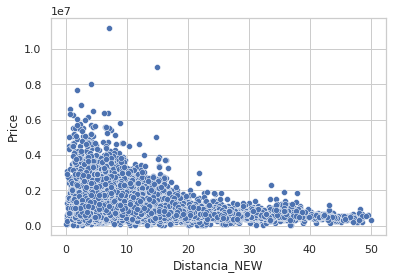

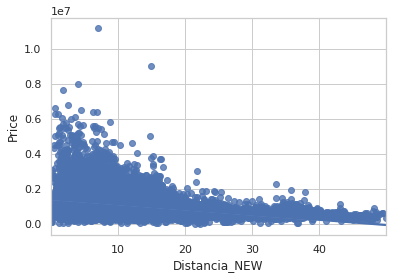

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount,Distancia_NEW,BathsAndRooms
count,26838.000000,2.683800e+04,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000,26838.000000
mean,3.097735,1.039176e+06,11.208574,3116.353678,1.619681,1.710932,556.124003,-37.811119,145.002520,7533.416201,12.809045,5.262765
std,0.964138,6.135293e+05,6.760064,111.424187,0.724612,1.000268,2963.598793,0.089491,0.119038,4342.511602,8.041983,61.759218
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-104.000000,-38.190430,144.540220,83.000000,0.061816,-2371.446312
25%,3.000000,6.350000e+05,6.400000,3049.000000,1.000000,1.000000,237.000000,-37.863008,144.933900,4407.000000,6.904165,3.380176
50%,3.000000,8.880000e+05,10.300000,3102.000000,2.000000,2.000000,493.000000,-37.807800,145.008000,6763.000000,11.461654,4.320287
75%,4.000000,1.280000e+06,14.000000,3153.750000,2.000000,2.000000,659.000000,-37.754400,145.072000,10331.000000,16.713029,5.886454
max,16.000000,1.120000e+07,47.300000,3978.000000,12.000000,26.000000,433014.000000,-37.395100,145.526350,21650.000000,49.959550,7899.742319


In [197]:

dataframe_jose = pd.read_csv('/home/ruben/tmp/HH_intro_git_ds/precios_casas_sinduplicados.csv')

data_filtered=dataframe_jose[dataframe_jose['Lattitude'].notnull() & \
                        dataframe_jose['Longtitude'].notnull() &\
                       dataframe_jose['Rooms'].notnull() & \
                       dataframe_jose['Bathroom'].notnull() & \
                       dataframe_jose['Price'].notnull()]



#Calculamos el precio medio por barrio
data_aux=data_filtered.groupby("Suburb")[["Price"]].mean().reset_index() 
#nos quedamos con el precio medio mas alta
data_aux[data_aux["Price"]==max(data_aux['Price'])]
#cogemos como centro para el calculo de distancia la latitud y longitud media del barrio mas caro
data_frameKoyong=data_filtered[(data_filtered["Suburb"]=='Kooyong')  &  (dataframe["Lattitude"]<-35.0) &
                             (dataframe["Lattitude"]>-39.0) &
                             (dataframe["Longtitude"]<147.0) &
                              (dataframe["Longtitude"]>143.0)]

Koyong_lat_mean=data_frameKoyong["Lattitude"].mean()
Koyong_lon_mean=data_frameKoyong["Longtitude"].mean()
#Calculamos la nueva distancia 
arr=[]
for lat, lon in zip(data_filtered['Lattitude'], data_filtered['Longtitude']):
    arr.append(distance((lat,lon), (Koyong_lat_mean,Koyong_lon_mean)).km)
    print(Koyong_lat_mean,Koyong_lon_mean)
    print(distance((lat,lon), (Koyong_lat_mean,Koyong_lon_mean)).km)

data_filtered["Distancia_NEW"]=arr
#Comprobamos si la correlaciñon mejora y verficamos que casi duplica 
data_filtered=data_filtered[data_filtered["Distancia_NEW"]<50]
sb.scatterplot(data=data_filtered, x="Distancia_NEW", y="Price")
#mostrar_graf_variables_continuas(dataframe_filtered,"Distance_SQR")
plot.show()

sb.regplot(data=data_filtered, x="Distancia_NEW", y="Price")
plot.show()
data_filtered["BathsAndRooms"]=(data_filtered["Rooms"]+data_filtered["Bathroom"])/data_filtered["Distancia_NEW"].apply(np.log10)



data_filtered.describe()


In [198]:
data_filtered.describe()
data_filtered.corr()



,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount,Distancia_NEW,BathsAndRooms
Rooms,1.000000,0.416335,0.266421,0.083101,0.614677,0.397281,0.035410,0.001229,0.107915,-0.054638,0.183204,0.020097
Price,0.416335,1.000000,-0.238312,0.028736,0.387676,0.183784,0.033393,-0.191382,0.168317,-0.047407,-0.390076,0.025011
Distance,0.266421,-0.238312,1.000000,0.477470,0.125931,0.244569,0.037383,-0.131178,0.234977,0.010240,0.772902,-0.011175
Postcode,0.083101,0.028736,0.477470,1.000000,0.116672,0.063138,0.026732,-0.250523,0.384289,0.033387,0.156001,0.004531
Bathroom,0.614677,0.387676,0.125931,0.116672,1.000000,0.317325,0.037558,-0.060663,0.110179,-0.034534,0.030822,0.024068
Car,0.397281,0.183784,0.244569,0.063138,0.317325,1.000000,0.035115,-0.013910,0.056640,-0.009335,0.176766,0.002668
Landsize,0.035410,0.033393,0.037383,0.026732,0.037558,0.035115,1.000000,0.002856,0.019937,-0.012209,0.027245,-0.000117
Lattitude,0.001229,-0.191382,-0.131178,-0.250523,-0.060663,-0.013910,0.002856,1.000000,-0.334211,0.017840,0.225864,-0.008977
Longtitude,0.107915,0.168317,0.234977,0.384289,0.110179,0.056640,0.019937,-0.334211,1.000000,0.009646,-0.307605,0.010187
Propertycount,-0.054638,-0.047407,0.010240,0.033387,-0.034534,-0.009335,-0.012209,0.017840,0.009646,1.000000,0.024549,-0.001358


In [136]:

        

dataframe_filtered=dataframe[(dataframe["Lattitude"]<-36.0) &
                             (dataframe["Lattitude"]>-38.0) &
                             (dataframe["Longtitude"]<146.0) &
                              (dataframe["Longtitude"]>144.0) ]
dataframe_filtered


,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bathroom,Car,Landsize,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount,Address_normalized
0,Abbotsford,68 Studley St,2,h,783079.0,SS,Jellis,3/09/2016,2.5,3067.0,1.0,1.0,126.0,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0,"68 Studley St, City of Melbourne, 3067, Australia"
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,1.0,1.0,202.0,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0,"85 Turner St, City of Melbourne, 3067, Australia"
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,1.0,0.0,156.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0,"25 Bloomburg St, City of Melbourne, 3067, Aust..."
3,Abbotsford,18/659 Victoria St,3,u,975391.0,VB,Rounds,4/02/2016,2.5,3067.0,2.0,1.0,0.0,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0,"18/659 Victoria St, City of Melbourne, 3067, A..."
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,2.0,0.0,134.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0,"5 Charles St, City of Melbourne, 3067, Australia"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34851,Yarraville,78 Bayview Rd,3,h,1101000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,1.0,288.0,Maribyrnong City Council,-37.81095,144.88516,Western Metropolitan,6543.0,"78 Bayview Rd, City of Melbourne, 3013, Australia"
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,1.0,3.0,593.0,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0,"13 Burns St, City of Melbourne, 3013, Australia"
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,2.0,1.0,98.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0,"29A Murray St, City of Melbourne, 3013, Australia"
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,1.0,2.0,220.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0,"147A Severn St, City of Melbourne, 3013, Austr..."


In [195]:
dataframe_filtered.to_csv('dataframe-ruben.csv')
print(dataframe_filtered)





           Suburb             Address  Rooms Type      Price Method  SellerG  \
0      Abbotsford       68 Studley St      2    h   783079.0     SS   Jellis   
1      Abbotsford        85 Turner St      2    h  1480000.0      S   Biggin   
2      Abbotsford     25 Bloomburg St      2    h  1035000.0      S   Biggin   
3      Abbotsford  18/659 Victoria St      3    u   975391.0     VB   Rounds   
4      Abbotsford        5 Charles St      3    h  1465000.0     SP   Biggin   
...           ...                 ...    ...  ...        ...    ...      ...   
34851  Yarraville       78 Bayview Rd      3    h  1101000.0      S      Jas   
34852  Yarraville         13 Burns St      4    h  1480000.0     PI      Jas   
34853  Yarraville       29A Murray St      2    h   888000.0     SP  Sweeney   
34854  Yarraville      147A Severn St      2    t   705000.0      S      Jas   
34856  Yarraville    3 Tarrengower St      2    h  1020000.0     PI       RW   

             Date  Distance  Postcode  

In [155]:

dataframe_filtered=dataframe[(dataframe["Lattitude"]<-36.0) &
                             (dataframe["Lattitude"]>-38.0) &
                             (dataframe["Longtitude"]<146.0) &
                              (dataframe["Longtitude"]>144.0) ]

dataframe_filtered.describe()

,Rooms,Price,Distance,Postcode,Bathroom,Car,Landsize,Lattitude,Longtitude,Propertycount
count,26318.000000,2.631800e+04,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000,26318.000000
mean,3.092370,1.044965e+06,10.799533,3111.440725,1.617448,1.704575,568.869709,-37.804817,144.998028,7505.400752
std,0.967309,6.167043e+05,6.111890,97.867553,0.724937,1.001198,3180.687286,0.081499,0.117776,4305.521238
min,1.000000,1.165300e+04,0.000000,3000.000000,0.000000,0.000000,-104.000000,-37.999960,144.423790,83.000000
25%,2.000000,6.400000e+05,6.300000,3047.000000,1.000000,1.000000,232.000000,-37.859198,144.931410,4442.000000
50%,3.000000,8.950000e+05,10.100000,3101.000000,2.000000,2.000000,486.000000,-37.805055,145.005400,6567.000000
75%,4.000000,1.290000e+06,13.900000,3150.000000,2.000000,2.000000,656.750000,-37.752700,145.067583,10331.000000
max,16.000000,1.120000e+07,48.100000,3805.000000,12.000000,26.000000,433014.000000,-37.390200,145.526350,21650.000000
